In [1]:
import uproot
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import time
import matplotlib.image as mpim
import matplotlib.animation as animation

/tmp/ipykernel_213011/1616106777.py:4: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [2]:
#open files
file = uproot.open("/nevis/riverside/data/isafa/MC/output_SBNOsc_NumuSelection_Modern_Uboone_Lite.root")
file2 = uproot.open("/nevis/riverside/data/isafa/MC/output_SBNOsc_NueSelection_Modern_UBOONE_Numu_Lite.root")
file3 = uproot.open("/nevis/riverside/data/isafa/MC/output_SBNOsc_NueSelection_Modern_UBOONE_Nu_Osc_Lite.root") 
file4 = uproot.open("/nevis/riverside/data/isafa/MC/output_SBNOsc_NueSelection_Modern_UBOONE_Intrinsic_Nue_Lite.root")

In [3]:
#grab the "protons on target" measurement for each dataset
pot = file["totpot"].member("fElements")[0] 
pot2 = file2["totpot"].member("fElements")[0]
pot3 = file3["totpot"].member("fElements")[0]
pot4 = file4["totpot"].member("fElements")[0]

#unpack each file and grab the relevant variables
Numu_cc = file["tree_numu_cc"].arrays(["reco_energy","true_energy","nu_pdg","true_baseline","weight"], library="pd")
Numu_nc = file["tree_numu_nc"].arrays(["reco_energy","true_energy","nu_pdg","true_baseline","weight"], library="pd")
Nue_Numu = file2["simpletree"].arrays(["reco_energy","true_energy","nu_pdg","true_baseline","weight"], library="pd")
Nue_NuOsc = file3["simpletree"].arrays(["reco_energy","true_energy","nu_pdg","true_baseline","weight"], library="pd")
Nue_Intrinsic = file4["simpletree"].arrays(["reco_energy","true_energy","nu_pdg","true_baseline","weight"], library="pd")

# doing our "final" weight calculation:
# weights = desired POT * simulated_weights / simulated_POT
des_pot = 1.2e+21
# using 1.2e21 as our desired POT as the ~total beam collected over microboone's lifetime
Numu_cc["pot_weight"] = Numu_cc["weight"] * (des_pot / pot)
Numu_nc["pot_weight"] = Numu_nc["weight"] * (des_pot / pot)
Nue_Numu["pot_weight"] = Nue_Numu["weight"] * (des_pot / pot2)
Nue_NuOsc["pot_weight"] = Nue_NuOsc["weight"] * (des_pot / pot3)
Nue_Intrinsic["pot_weight"] = Nue_Intrinsic["weight"] * (des_pot / pot4)


In [4]:
#split datasets into neutrino types
cc_mu = Numu_cc[(Numu_cc["nu_pdg"] == 14.0)]
cc_mua = Numu_cc[(Numu_cc["nu_pdg"] == -14.0)]
nc_mu = Numu_nc[(Numu_nc["nu_pdg"] == 14.0)]
nc_mua = Numu_nc[(Numu_nc["nu_pdg"] == -14.0)]
osc_e = Nue_NuOsc[(Nue_NuOsc["nu_pdg"] == 12.0)]
osc_ea = Nue_NuOsc[(Nue_NuOsc["nu_pdg"] == -12.0)]
intrin_e = Nue_Intrinsic[(Nue_Intrinsic["nu_pdg"] == 12.0)]
intrin_ea = Nue_Intrinsic[(Nue_Intrinsic["nu_pdg"] == -12.0)]

In [5]:
# probability for mu->e, e->e, and mu->mu oscillations
# in terms of Ue4, Um4, and deltam2_41
def prob_energy(Ue4, Um4, deltam_41, L_E, Paa="mue"):
    
    # probability for mu->e oscillation (nue appearance)
    if (Paa=="mue"):
        #sin2(2*theta_mue) = sin2(2*theta_14)sin2(theta_24) = 4 * (U_m4)^2 * (U_e4)^2
        probab = ((4*(Ue4**2)*(Um4)**2) * (np.sin(1.27*deltam_41*L_E))**2)
        
    # probability for e->e (nue survival)
    elif (Paa=="ee"):
        #sin2(2*theta_ee) = sin2(2*theta_14) = 4 * (1-(U_e4)^2) * (U_e4)^2
        probab =  1 - ((4*(Ue4**2)*(1-(Ue4)**2)) * (np.sin(1.27*deltam_41*L_E))**2)
        
    # probability for mu->mu (mue survival)
    elif (Paa=="mumu"):
        # sin2(2*theta_mumu) = 4*cos2(theta_14)*sin2(theta_24)*[1 - cos2(theta_14)*sin2(theta_24)]
        # = 4 * (1-(U_m4)^2) * (U_m4)^2
        probab = 1 - ((4*(Um4**2)*(1-(Um4)**2)) * (np.sin(1.27*deltam_41*L_E))**2)
        
    else:
        print("Choose which oscillation type you want: mue, ee, mumu")
        return(0)
        
    return(probab)


In [6]:
# create my covariance matrix:
# the diagonals are cov2_sys_i + sigma2_stat_i
# the off-diagonals are rho_ij*cov_sys_i*cov_sys_j
# we can make 4 seperate matrices: flux, cross-section, detector, and statistical and add them together (basically in quadrature)
# the matrix will be a (N_nue + N_numu) square

flux_sig = 0.15
flux_rho = 0.5

cross_sig = 0.2
cross_rho = 1

detect_sig = 0.03
detect_rho = 0

In [7]:
#if the expected count is 0, the sum goes to infinity, so just skip those boxes for right now
def chi2(expect, obs, error="poisson", dof_normalize=False, subtract_from_dof=0):
    if (np.isin(expect,0).any()):
        print("The expected freqency has a bin with 0 entries")
        return
    
    if (error=="poisson"):
        # uncorrelated data with poisson only error
        # sigma = sqrt(expected)
        # diff^2 / sigma^2
        diff = obs - expect
        diff2 = diff**2
        diff3 = diff2/expect
        
        chi2 =0
        n = 0
        for i in diff3:
            n = n+1
            if (np.isinf(i)):
                continue
            chi2 = chi2 + i

        if(dof_normalize):
            dof = n - subtract_from_dof
            chi2 = chi2/dof
            #print("chi2 per dof (" + str(dof) +"): "+str(chi2))
            return chi2
        else:
            #print("total chi2: " + str(chi2))
            return chi2
        
        
    elif (error=="correlated"):
        #this is for both nue and numu data that has correlated errors
        # assuming that the bins have already been appended together into the expect and obs arrays
        # currently only has non-dof-normalized option
        #print("inside correlated")
        
        stat_cov = np.zeros([expect.shape[0], expect.shape[0]])
        fractional_error = expect/(expect**2)
        np.fill_diagonal(stat_cov, fractional_error)
        # print("expect")
        # print(expect)
        # print("stat_cov")
        # print(stat_cov)
        
        flux_cov = np.zeros([expect.shape[0], expect.shape[0]])
        flux_cov.fill(flux_sig*flux_sig*flux_rho)
        np.fill_diagonal(flux_cov, flux_sig*flux_sig*1)
        # print("flux_cov")
        # print(flux_cov)
        
        cross_cov = np.zeros([expect.shape[0], expect.shape[0]])
        cross_cov.fill(cross_sig*cross_sig*cross_rho)
        np.fill_diagonal(cross_cov, cross_sig*cross_sig*1)
        # print("cross_cov")
        # print(cross_cov)
        
        detect_cov = np.zeros([expect.shape[0], expect.shape[0]])
        detect_cov.fill(detect_sig*detect_sig*detect_rho)
        np.fill_diagonal(detect_cov, detect_sig*detect_sig*1)
        # print("detect_cov")
        # print(detect_cov)
        
        fract_cov = stat_cov + flux_cov + cross_cov + detect_cov
        # print("fract_cov")
        # print(fract_cov)
        
        cov = fract_cov.copy()
        for i in range(expect.shape[0]):
            for j in range(expect.shape[0]):
                cov[i][j] = cov[i][j] * expect[i] * expect[j]
                
        # print("cov")
        # print(cov)
        
        inverse_cov = np.linalg.inv(cov)
        # print("inverse_cov")
        # print(inverse_cov)
        
        chi2 = 0
        for i in range(len(expect)):
            for j in range(len(expect)):
                dif1 = obs[i] - expect[i]
                dif2 = obs[j] - expect[j]
                diff2 = dif1*dif2
                
                diff3 = diff2 * inverse_cov[i][j] #or should it be j,i now that its inversed? 
                chi2 = chi2 + diff3
                # print(i, j)
                # print("obsi", obs[i], "expecti", expect[i])
                # print("obsj", obs[j], "expectj", expect[j])
                # print("diffs", dif1, dif2, diff2)
                # print("covariance element", inverse_cov[i][j])
                # print("chi2 element", diff3)
                # print("total chi2", chi2)
            
        return (chi2)


In [8]:
#make a function that takes in oscillation parameters and the intrinsic and oscilation data and spits out the chi2 value
#def osc_chi2(deltam2, thetaee, thetamue, intrin_data, osc_data, n=1):

variable_bins = np.array([0.16, 0.46, 0.76, 1.06, 1.36, 1.66, 1.96, 2.26, 2.56, 2.86, 3.16, 3.46, 3.76, 4.06, 6.00])
bins_widths = np.array([0.3, 0.3, 0.3, 0.3, 0.3, 0.3, 0.3, 0.3, 0.3, 0.3, 0.3, 0.3, 0.3, 1.94])
bin_centers = np.array([0.31, 0.61, 0.91, 1.21, 1.51, 1.81, 2.11, 2.41, 2.71, 3.01, 3.31, 3.61, 3.91, 5.03])

#unosc_intrinisc_nue_mc and fullosc_mc AND unosc_intrinsic_numu_mc
def osc_chi2(params, unosc_intrinsic_nue_mc, fullosc_mc,unosc_intrinsic_numu_mc, n=1):
    deltam2, Ue4, Um4 = params
    nue_survival_probs = prob_energy(Ue4, Um4, deltam2, (unosc_intrinsic_nue_mc["true_baseline"]/1000)/unosc_intrinsic_nue_mc["true_energy"], Paa="ee")
    nue_appearance_probs = prob_energy(Ue4, Um4, deltam2, (fullosc_mc["true_baseline"]/1000)/fullosc_mc["true_energy"], Paa="mue")
    numu_survival_probs = prob_energy(Ue4, Um4, deltam2, (unosc_intrinsic_numu_mc["true_baseline"]/1000)/unosc_intrinsic_numu_mc["true_energy"], Paa="mumu")
    
    nue_survival_weight = unosc_intrinsic_nue_mc["pot_weight"] * nue_survival_probs
    nue_appearance_weight = fullosc_mc["pot_weight"] * nue_appearance_probs
    numu_survival_weight = unosc_intrinsic_numu_mc["pot_weight"] * numu_survival_probs
    
    nue_intrinsic = np.histogram(unosc_intrinsic_nue_mc["true_energy"], bins=variable_bins, weights=unosc_intrinsic_nue_mc["pot_weight"]) #total intrinsic nue
    #plt.stairs(nue_intrinsic[0]/bins_widths, nue_intrinsic[1])
    #plt.show()
       
    nue_survival = np.histogram(unosc_intrinsic_nue_mc["true_energy"], bins=nue_intrinsic[1], weights=nue_survival_weight) #intrinsic nue with oscillation disappearance
    nue_appearance = np.histogram(fullosc_mc["true_energy"], bins=nue_intrinsic[1], weights=nue_appearance_weight) #oscilated numu->nue
    
    #now try adding the numu histogram
    numu_intrinsic = np.histogram(unosc_intrinsic_numu_mc["true_energy"], bins=variable_bins, weights=unosc_intrinsic_numu_mc["pot_weight"]) #total intrinsic numu
    numu_survival = np.histogram(unosc_intrinsic_numu_mc["true_energy"], bins=nue_intrinsic[1], weights=numu_survival_weight) #intrinsic numu with oscillation disappearance
    
    #appending together nue and numu
    intrinsic_nu = np.concatenate([nue_intrinsic[0], numu_intrinsic[0]])
    signal_nu = np.concatenate([nue_survival[0]+nue_appearance[0], numu_survival[0]])
    
    nue_chi2_val = chi2(nue_intrinsic[0], nue_survival[0]+nue_appearance[0], dof_normalize=False, subtract_from_dof=3, error="correlated")
    numu_chi2_val = chi2(numu_intrinsic[0], numu_survival[0], dof_normalize=False, subtract_from_dof=3, error="correlated")
    total_chi2_val = chi2(intrinsic_nu, signal_nu, dof_normalize=False, subtract_from_dof=3, error="correlated")
    
#     #if (chi2_val > 5):
#     #plt.subplot(sin2s_mue.shape[0], deltam2s.shape[0],n)
#         # plt.hist([unosc_intrinsic_nue_mc["true_energy"], fullosc_mc["true_energy"]], bins=nue_intrinsic[1], histtype="barstacked", edgecolor="black", label=["Intrinsic Survival Nue","Appearance Nue"], weights=[nue_survival_weight,nue_appearance_weight])
#         # plt.hist(unosc_intrinsic_nue_mc["true_energy"], bins=nue_intrinsic[1], color="red", histtype="step", label="Unoscillated Intrinsic Nue", weights=unosc_intrinsic_nue_mc["pot_weight"])
#         # plt.errorbar(bin_centers,nue_intrinsic[0], yerr=np.sqrt(nue_intrinsic[0]), fmt=" ", color="red", capsize=5)
#         # plt.errorbar(bin_centers, nue_survival[0]+nue_appearance[0], yerr= np.sqrt(nue_survival[0]+nue_appearance[0]), fmt=" ", color="black", capsize=5)
#         # plt.legend()
#         # plt.ylabel("Events")
#         # plt.xlabel("Energy {GeV}")
#         # plt.title("Intrinsic and Oscillated $\\nu_e$ \n$\Delta{m}^2=$" + str(deltam2) + " and $sin^2(2\\theta_{mue})=$" + str(sin2mue) + " and $sin^2(2\\theta_{ee})=$" + str(sin2ee) + "\n$\\chi^2=$" + str(round(chi2_val,5)))
#         # plt.show()
        
#     plt.figure(figsize=(20,5))
#     plt.subplot(131)
#     plt.hist([unosc_intrinsic_nue_mc["true_energy"], fullosc_mc["true_energy"]], bins=nue_intrinsic[1], histtype="barstacked", edgecolor="black", label=["Intrinsic Survival Nue","Appearance Nue"], weights=[nue_survival_weight,nue_appearance_weight])
#     plt.hist(unosc_intrinsic_nue_mc["true_energy"], bins=nue_intrinsic[1], color="red", histtype="step", label="Unoscillated Intrinsic Nue", weights=unosc_intrinsic_nue_mc["pot_weight"])
#     plt.errorbar(bin_centers,nue_intrinsic[0], yerr=np.sqrt(nue_intrinsic[0]), fmt=" ", color="red", capsize=5)
#     plt.errorbar(bin_centers, nue_survival[0]+nue_appearance[0], yerr= np.sqrt(nue_survival[0]+nue_appearance[0]), fmt=" ", color="black", capsize=5)
#     plt.legend()
#     plt.ylabel("Events")
#     plt.xlabel("Energy {GeV}")
#     plt.title("Intrinsic and Oscillated $\\nu_e$ \n$\Delta{m}^2=$" + str(deltam2) + " and $U_{e4}^2=$" + str(Ue4**2) + " and $U_{\\mu4}^2=$" + str(round(Um4**2, 4)) + "\n$\\chi^2=$" + str(round(nue_chi2_val,5)))
# #     plt.show()
    
    
#     plt.subplot(132)
#     plt.hist(unosc_intrinsic_numu_mc["true_energy"], bins=nue_intrinsic[1], histtype="step", weights = numu_survival_weight, label="Intrinsic Numu Survival")
#     plt.hist(unosc_intrinsic_numu_mc["true_energy"], bins=nue_intrinsic[1], histtype="step", weights= unosc_intrinsic_numu_mc["pot_weight"], label="Unoscillated Intrinsic Numu")
#     plt.errorbar(bin_centers,numu_intrinsic[0], yerr=np.sqrt(numu_intrinsic[0]), fmt=" ", color="red", capsize=5)
#     plt.errorbar(bin_centers, numu_survival[0], yerr= np.sqrt(numu_survival[0]), fmt=" ", color="black", capsize=5)
#     plt.legend()
#     plt.ylabel("Events")
#     plt.xlabel("Energy {GeV}")
#     plt.title("Intrinsic and Oscillated $\\nu_{\\mu}$ \n$\Delta{m}^2=$" + str(deltam2) + " and $U_{e4}^2=$" + str(Ue4**2) + " and $U_{\\mu4}^2=$" + str(round(Um4**2, 4)) + "\n$\\chi^2=$" + str(round(numu_chi2_val,5)))
# #     plt.show()
    
#     plt.subplot(133)
#     plt.plot(intrinsic_nu, label="intrinsic")
#     plt.plot(signal_nu, label="signal")
#     plt.yscale("log")
#     plt.legend()
#     plt.ylabel("Events")
#     plt.xlabel("Nue then Numu Energies")
#     plt.title("$\Delta{m}^2=$" + str(deltam2) + " and $U_{e4}^2=$" + str(Ue4**2) + " and $U_{\\mu4}^2=$" + str(round(Um4**2, 4)) + "\n$\\chi^2=$" + str(round(total_chi2_val,5)))
#     # plt.show()
    
    return (nue_chi2_val, numu_chi2_val, total_chi2_val)



In [9]:
osc_chi2([10, 0.3, 0.1], intrin_e, osc_e, cc_mu)

(17.535037458744586, 0.17721261070648692, 22.656404964729365)

$\chi^2 = \sum_{j}^{N}{\sum_{i}^N{(Osc_i - Unosc_i)*M^{-1}_{ij}*(Osc_j - Unosc_j)}}$

Where $M$ is the full covariance matrix encapsulating the following errors added in quadrature:

- $\sigma^2$ statistical error = $N_i$

- $\sigma^2_{flux}$ systematic flux error = $N_i*N_j*\sigma_{flux,i}*\sigma_{flux,j}*\rho_{ij}$

- $\sigma^2_{cross}$ systematic cross-section error = $N_i*N_j*\sigma_{cross,i}*\sigma_{cross,j}*\rho_{ij}$

- $\sigma^2_{detect}$ systematic detection error = $N_i*N_j*\sigma_{detect,i}*\sigma_{detect,j}*\rho_{ij}$

*$\rho_{ij}$ is the correlation coefficient between bins i and j


$\Delta{m^2_{41}}$, $U_{e4}$, $U_{\mu4}$

In [10]:
deltam2s = np.logspace(np.log10(0.1),np.log10(10),30, base=10)

#if I want sin2_mue = [1e-5, 0.1] and sin2_ee = [0,0.5]
#sin2(2*theta_mue) = sin2(2*theta_14)sin2(theta_24) = 4 * (U_m4)^2 * (U_e4)^2
#sin2(2*theta_ee) = sin2(2*theta_14) = 4 * (1-(U_e4)^2) * (U_e4)^2

Ue4s = np.logspace(np.log10(0.01), np.log10(0.4), 30, base=10)
Um4s = np.logspace(np.log10(0.01), np.log10(0.4), 30, base=10)

In [11]:
# #try a 3D plot
# chi2_3d_with_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# chi2_3d_only_nue = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# chi2_3d_only_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))

# #break it up into 6 sections
# start= time.time()
# #for i in range(deltam2s.shape[0]):
# for i in range(5):
#     print("Event i:", str(i))
#     t = time.time() - start
#     print("Time elapsed in seconds since starting cell:", str(t))
#     for j in range(Ue4s.shape[0]):
#         for k in range(Um4s.shape[0]):
#             nue_chi2, numu_chi2, total_chi2 = osc_chi2([deltam2s[i], Ue4s[j], Um4s[k]], intrin_e, osc_e, cc_mu)
#             chi2_3d_with_numu[i][j][k] = total_chi2
#             chi2_3d_only_nue[i][j][k] = nue_chi2
#             chi2_3d_only_numu[i][j][k] = numu_chi2
#             #print("Event " + str(i) + "-" + str(j) + "-" + str(k) + " completed")
#         #n = n+1
 
    
# np.save("chi23d_30x30x30_with_numu_array_1.npy", chi2_3d_with_numu)
# np.save("chi23d_30x30x30_only_nue_array_1.npy", chi2_3d_only_nue)
# np.save("chi23d_30x30x30_only_numu_array_1.npy", chi2_3d_only_numu)

# #try a 3D plot
# chi2_3d_with_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# chi2_3d_only_nue = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# chi2_3d_only_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))

# #break it up into 6 sections
# start= time.time()
# #for i in range(deltam2s.shape[0]):
# for i in range(5,10):
#     print("Event i:", str(i))
#     t = time.time() - start
#     print("Time elapsed in seconds since starting cell:", str(t))
#     for j in range(Ue4s.shape[0]):
#         for k in range(Um4s.shape[0]):
#             nue_chi2, numu_chi2, total_chi2 = osc_chi2([deltam2s[i], Ue4s[j], Um4s[k]], intrin_e, osc_e, cc_mu)
#             chi2_3d_with_numu[i][j][k] = total_chi2
#             chi2_3d_only_nue[i][j][k] = nue_chi2
#             chi2_3d_only_numu[i][j][k] = numu_chi2
#             #print("Event " + str(i) + "-" + str(j) + "-" + str(k) + " completed")
#         #n = n+1
 
    
# np.save("chi23d_30x30x30_with_numu_array_2.npy", chi2_3d_with_numu)
# np.save("chi23d_30x30x30_only_nue_array_2.npy", chi2_3d_only_nue)
# np.save("chi23d_30x30x30_only_numu_array_2.npy", chi2_3d_only_numu)

# #try a 3D plot
# chi2_3d_with_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# chi2_3d_only_nue = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# chi2_3d_only_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))

# #break it up into 6 sections
# start= time.time()
# #for i in range(deltam2s.shape[0]):
# for i in range(10,15):
#     print("Event i:", str(i))
#     t = time.time() - start
#     print("Time elapsed in seconds since starting cell:", str(t))
#     for j in range(Ue4s.shape[0]):
#         for k in range(Um4s.shape[0]):
#             nue_chi2, numu_chi2, total_chi2 = osc_chi2([deltam2s[i], Ue4s[j], Um4s[k]], intrin_e, osc_e, cc_mu)
#             chi2_3d_with_numu[i][j][k] = total_chi2
#             chi2_3d_only_nue[i][j][k] = nue_chi2
#             chi2_3d_only_numu[i][j][k] = numu_chi2
#             #print("Event " + str(i) + "-" + str(j) + "-" + str(k) + " completed")
#         #n = n+1
 
    
# np.save("chi23d_30x30x30_with_numu_array_3.npy", chi2_3d_with_numu)
# np.save("chi23d_30x30x30_only_nue_array_3.npy", chi2_3d_only_nue)
# np.save("chi23d_30x30x30_only_numu_array_3.npy", chi2_3d_only_numu)

# #try a 3D plot
# chi2_3d_with_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# chi2_3d_only_nue = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# chi2_3d_only_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))

# #break it up into 6 sections
# start= time.time()
# #for i in range(deltam2s.shape[0]):
# for i in range(15,20):
#     print("Event i:", str(i))
#     t = time.time() - start
#     print("Time elapsed in seconds since starting cell:", str(t))
#     for j in range(Ue4s.shape[0]):
#         for k in range(Um4s.shape[0]):
#             nue_chi2, numu_chi2, total_chi2 = osc_chi2([deltam2s[i], Ue4s[j], Um4s[k]], intrin_e, osc_e, cc_mu)
#             chi2_3d_with_numu[i][j][k] = total_chi2
#             chi2_3d_only_nue[i][j][k] = nue_chi2
#             chi2_3d_only_numu[i][j][k] = numu_chi2
#             #print("Event " + str(i) + "-" + str(j) + "-" + str(k) + " completed")
#         #n = n+1
 
    
# np.save("chi23d_30x30x30_with_numu_array_4.npy", chi2_3d_with_numu)
# np.save("chi23d_30x30x30_only_nue_array_4.npy", chi2_3d_only_nue)
# np.save("chi23d_30x30x30_only_numu_array_4.npy", chi2_3d_only_numu)

# #try a 3D plot
# chi2_3d_with_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# chi2_3d_only_nue = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# chi2_3d_only_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))

# #break it up into 6 sections
# start= time.time()
# #for i in range(deltam2s.shape[0]):
# for i in range(20,25):
#     print("Event i:", str(i))
#     t = time.time() - start
#     print("Time elapsed in seconds since starting cell:", str(t))
#     for j in range(Ue4s.shape[0]):
#         for k in range(Um4s.shape[0]):
#             nue_chi2, numu_chi2, total_chi2 = osc_chi2([deltam2s[i], Ue4s[j], Um4s[k]], intrin_e, osc_e, cc_mu)
#             chi2_3d_with_numu[i][j][k] = total_chi2
#             chi2_3d_only_nue[i][j][k] = nue_chi2
#             chi2_3d_only_numu[i][j][k] = numu_chi2
#             #print("Event " + str(i) + "-" + str(j) + "-" + str(k) + " completed")
#         #n = n+1
 
    
# np.save("chi23d_30x30x30_with_numu_array_5.npy", chi2_3d_with_numu)
# np.save("chi23d_30x30x30_only_nue_array_5.npy", chi2_3d_only_nue)
# np.save("chi23d_30x30x30_only_numu_array_5.npy", chi2_3d_only_numu)

# #try a 3D plot
# chi2_3d_with_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# chi2_3d_only_nue = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# chi2_3d_only_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))

# #break it up into 6 sections
# start= time.time()
# #for i in range(deltam2s.shape[0]):
# for i in range(25,30):
#     print("Event i:", str(i))
#     t = time.time() - start
#     print("Time elapsed in seconds since starting cell:", str(t))
#     for j in range(Ue4s.shape[0]):
#         for k in range(Um4s.shape[0]):
#             nue_chi2, numu_chi2, total_chi2 = osc_chi2([deltam2s[i], Ue4s[j], Um4s[k]], intrin_e, osc_e, cc_mu)
#             chi2_3d_with_numu[i][j][k] = total_chi2
#             chi2_3d_only_nue[i][j][k] = nue_chi2
#             chi2_3d_only_numu[i][j][k] = numu_chi2
#             #print("Event " + str(i) + "-" + str(j) + "-" + str(k) + " completed")
#         #n = n+1
 
    
# np.save("chi23d_30x30x30_with_numu_array_6.npy", chi2_3d_with_numu)
# np.save("chi23d_30x30x30_only_nue_array_6.npy", chi2_3d_only_nue)
# np.save("chi23d_30x30x30_only_numu_array_6.npy", chi2_3d_only_numu)

In [12]:
# both_array_1 = np.load("chi23d_30x30x30_with_numu_array_1.npy")
# nue_array_1 = np.load("chi23d_30x30x30_only_nue_array_1.npy")
# numu_array_1 =  np.load("chi23d_30x30x30_only_numu_array_1.npy")

# both_array_2 = np.load("chi23d_30x30x30_with_numu_array_2.npy")
# nue_array_2 = np.load("chi23d_30x30x30_only_nue_array_2.npy")
# numu_array_2 =  np.load("chi23d_30x30x30_only_numu_array_2.npy")

# both_array_3 = np.load("chi23d_30x30x30_with_numu_array_3.npy")
# nue_array_3 = np.load("chi23d_30x30x30_only_nue_array_3.npy")
# numu_array_3 =  np.load("chi23d_30x30x30_only_numu_array_3.npy")

# both_array_4 = np.load("chi23d_30x30x30_with_numu_array_4.npy")
# nue_array_4 = np.load("chi23d_30x30x30_only_nue_array_4.npy")
# numu_array_4 =  np.load("chi23d_30x30x30_only_numu_array_4.npy")

# both_array_5 = np.load("chi23d_30x30x30_with_numu_array_5.npy")
# nue_array_5 = np.load("chi23d_30x30x30_only_nue_array_5.npy")
# numu_array_5 =  np.load("chi23d_30x30x30_only_numu_array_5.npy")

# both_array_6 = np.load("chi23d_30x30x30_with_numu_array_6.npy")
# nue_array_6 = np.load("chi23d_30x30x30_only_nue_array_6.npy")
# numu_array_6 =  np.load("chi23d_30x30x30_only_numu_array_6.npy")

# chi2_3d_with_numu = np.concatenate([both_array_1[0:5], both_array_2[5:10], both_array_3[10:15], both_array_4[15:20], both_array_5[20:25], both_array_6[25:30]], axis=0)
# chi2_3d_only_nue =  np.concatenate([nue_array_1[0:5], nue_array_2[5:10], nue_array_3[10:15], nue_array_4[15:20], nue_array_5[20:25], nue_array_6[25:30]], axis=0)
# chi2_3d_only_numu =  np.concatenate([numu_array_1[0:5], numu_array_2[5:10], numu_array_3[10:15], numu_array_4[15:20], numu_array_5[20:25], numu_array_6[25:30]], axis=0)

# np.save("chi23d_30x30x30_with_numu_array.npy", chi2_3d_with_numu)
# np.save("chi23d_30x30x30_only_nue_array.npy", chi2_3d_only_nue)
# np.save("chi23d_30x30x30_only_numu_array.npy", chi2_3d_only_numu)


In [13]:
# DO THIS ONE!!
#load in the 30x30x30 dataset

chi2_3d_with_numu =  np.load("chi23d_30x30x30_with_numu_array.npy")
chi2_3d_only_nue =  np.load("chi23d_30x30x30_only_nue_array.npy")
chi2_3d_only_numu =  np.load("chi23d_30x30x30_only_numu_array.npy")

Text(0.5, 0.92, '$\\nu_{e}$ and $\\nu_{\\mu}$ Spectra $\\chi^2$ Sensitivity to Variations in $U_{e4}^2$, $U_{\\mu4}^2$, and $\\Delta{m}_{41}^2$ \nPOT = 1.2e+21')

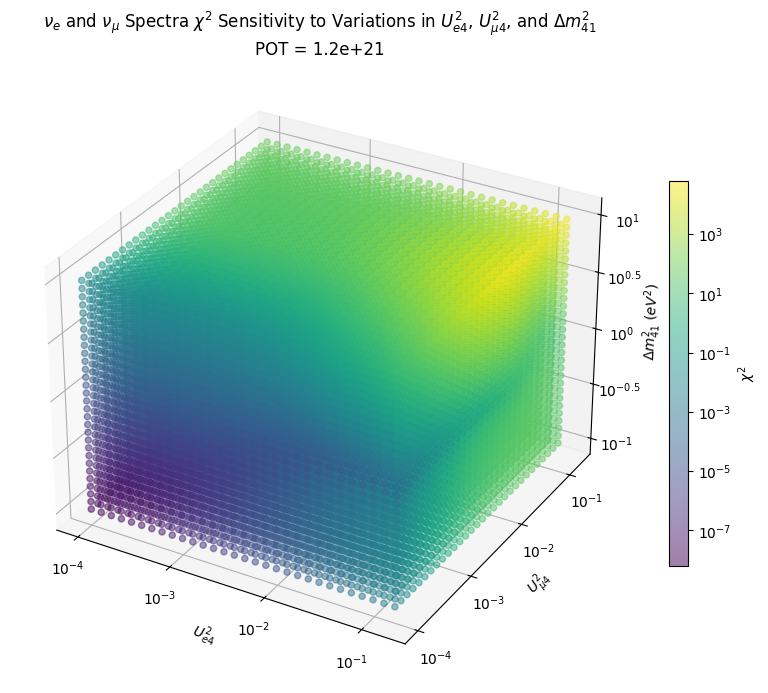

In [14]:
#try plotting a 3d scatterplot with colors=chi2 correspondance (no contours)

#apparantly you can't do a log scale axis in 3d scatterplot, so manually take the log myself, then plot on a linear scale
#Ue4_3d, Um4_3d, deltm3d = np.meshgrid(Ue4s, Um4s, deltam2s) 

#try doing it with Ue4^2 and Um4^2
Ue4_3d, Um4_3d, deltm3d = np.meshgrid(Ue4s**2, Um4s**2, deltam2s)

Ue4_3d_log = np.log10(Ue4_3d)
Um4_3d_log = np.log10(Um4_3d)
deltm3d_log = np.log10(deltm3d)

fig = plt.figure(figsize=(10,10))
ax = plt.axes(projection="3d")

scattr = ax.scatter3D(Ue4_3d_log, Um4_3d_log, deltm3d_log, c=chi2_3d_with_numu, norm="log", alpha=0.5)
ax.set_xlabel("$U_{e4}^2$")
ax.set_xticks([-4,-3,-2,-1], labels=["$10^{-4}$", "$10^{-3}$", "$10^{-2}$", "$10^{-1}$"])
ax.set_ylabel("$U_{\mu4}^2$")
ax.set_yticks([-4,-3,-2,-1], labels=["$10^{-4}$", "$10^{-3}$", "$10^{-2}$", "$10^{-1}$"])
ax.set_zlabel("$\Delta{m}^2_{41}$ ($eV^2$)")
ax.set_zticks([-1,-0.5,0,0.5,1], labels=["$10^{-1}$", "$10^{-0.5}$", "$10^{0}$", "$10^{0.5}$", "$10^{1}$"])

fig.colorbar(scattr, label="$\\chi^2$", shrink=0.5, location="right") 
ax.set_title("$\\nu_{e}$ and $\\nu_{\mu}$ Spectra $\chi^2$ Sensitivity to Variations in $U_{e4}^2$, $U_{\mu4}^2$, and $\\Delta{m}_{41}^2$ \nPOT = 1.2e+21", fontsize="large")



Text(0.5, 0.92, '$\\nu_{e}$ Spectra $\\chi^2$ Sensitivity to Variations in $U_{e4}^2$, $U_{\\mu4}^2$, and $\\Delta{m}_{41}^2$ \nPOT = 1.2e+21')

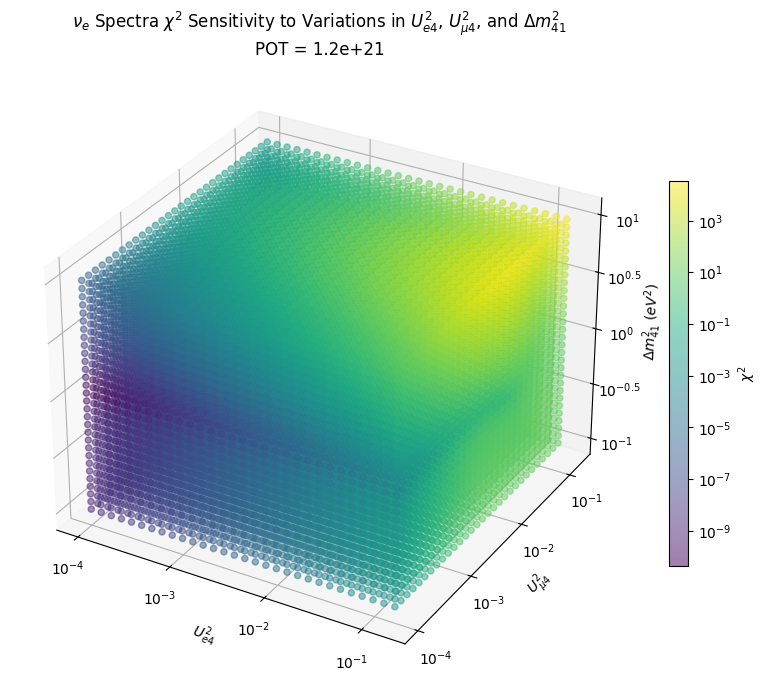

In [15]:
#just looking at nue spectra

#apparantly you can't do a log scale axis in 3d scatterplot, so manually take the log myself, then plot on a linear scale
#Ue4_3d, Um4_3d, deltm3d = np.meshgrid(Ue4s, Um4s, deltam2s) 

#try doing it with Ue4^2 and Um4^2
Ue4_3d, Um4_3d, deltm3d = np.meshgrid(Ue4s**2, Um4s**2, deltam2s)

Ue4_3d_log = np.log10(Ue4_3d)
Um4_3d_log = np.log10(Um4_3d)
deltm3d_log = np.log10(deltm3d)

fig = plt.figure(figsize=(10,10))
ax = plt.axes(projection="3d")

scattr = ax.scatter3D(Ue4_3d_log, Um4_3d_log, deltm3d_log, c=chi2_3d_only_nue, norm="log", alpha=0.5)
ax.set_xlabel("$U_{e4}^2$")
ax.set_xticks([-4,-3,-2,-1], labels=["$10^{-4}$", "$10^{-3}$", "$10^{-2}$", "$10^{-1}$"])
ax.set_ylabel("$U_{\mu4}^2$")
ax.set_yticks([-4,-3,-2,-1], labels=["$10^{-4}$", "$10^{-3}$", "$10^{-2}$", "$10^{-1}$"])
ax.set_zlabel("$\Delta{m}^2_{41}$ ($eV^2$)")
ax.set_zticks([-1,-0.5,0,0.5,1], labels=["$10^{-1}$", "$10^{-0.5}$", "$10^{0}$", "$10^{0.5}$", "$10^{1}$"])

fig.colorbar(scattr, label="$\\chi^2$", shrink=0.5, location="right") 
ax.set_title("$\\nu_{e}$ Spectra $\chi^2$ Sensitivity to Variations in $U_{e4}^2$, $U_{\mu4}^2$, and $\\Delta{m}_{41}^2$ \nPOT = 1.2e+21", fontsize="large")



Text(0.5, 0.92, '$\\nu_{\\mu}$ Spectra $\\chi^2$ Sensitivity to Variations in $U_{e4}^2$, $U_{\\mu4}^2$, and $\\Delta{m}_{41}^2$ \nPOT = 1.2e+21')

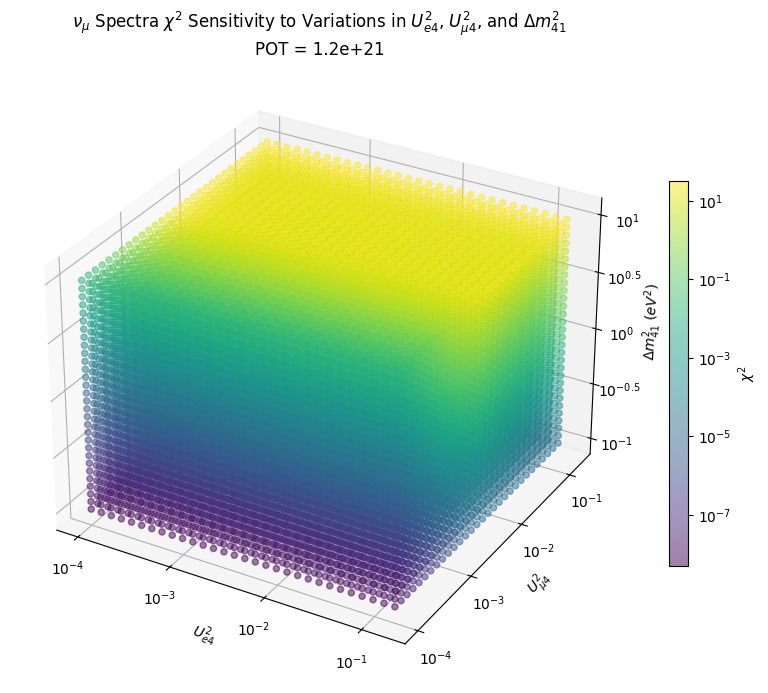

In [16]:
#just the numu spectra

#apparantly you can't do a log scale axis in 3d scatterplot, so manually take the log myself, then plot on a linear scale
#Ue4_3d, Um4_3d, deltm3d = np.meshgrid(Ue4s, Um4s, deltam2s) 

#try doing it with Ue4^2 and Um4^2
Ue4_3d, Um4_3d, deltm3d = np.meshgrid(Ue4s**2, Um4s**2, deltam2s)

Ue4_3d_log = np.log10(Ue4_3d)
Um4_3d_log = np.log10(Um4_3d)
deltm3d_log = np.log10(deltm3d)

fig = plt.figure(figsize=(10,10))
ax = plt.axes(projection="3d")

scattr = ax.scatter3D(Ue4_3d_log, Um4_3d_log, deltm3d_log, c=chi2_3d_only_numu, norm="log", alpha=0.5)
ax.set_xlabel("$U_{e4}^2$")
ax.set_xticks([-4,-3,-2,-1], labels=["$10^{-4}$", "$10^{-3}$", "$10^{-2}$", "$10^{-1}$"])
ax.set_ylabel("$U_{\mu4}^2$")
ax.set_yticks([-4,-3,-2,-1], labels=["$10^{-4}$", "$10^{-3}$", "$10^{-2}$", "$10^{-1}$"])
ax.set_zlabel("$\Delta{m}^2_{41}$ ($eV^2$)")
ax.set_zticks([-1,-0.5,0,0.5,1], labels=["$10^{-1}$", "$10^{-0.5}$", "$10^{0}$", "$10^{0.5}$", "$10^{1}$"])

fig.colorbar(scattr, label="$\\chi^2$", shrink=0.5, location="right") 
ax.set_title("$\\nu_{\mu}$ Spectra $\chi^2$ Sensitivity to Variations in $U_{e4}^2$, $U_{\mu4}^2$, and $\\Delta{m}_{41}^2$ \nPOT = 1.2e+21", fontsize="large")



In [17]:
# assign significant values for chi2
# # 2 degrees of freedom
# dof = 2
# cl_90 = 4.605
# cl_99 = 9.210
# cl_999 = 13.816

# 3 degrees of freedom
dof = 3
cl_90 = 6.251
cl_99 = 11.345
cl_999 = 16.266

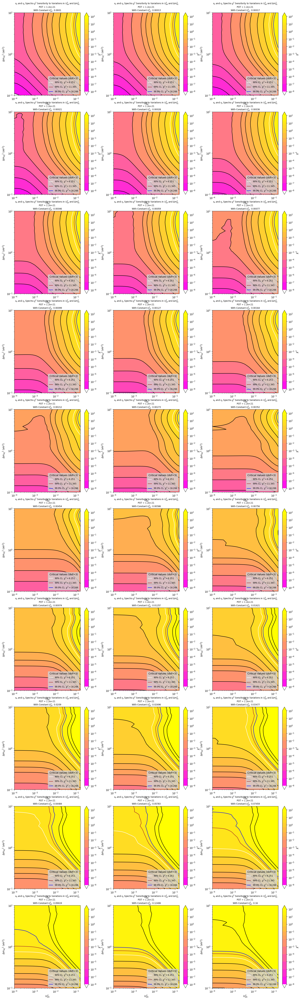

In [18]:
# make contour plots in U_e4 and deltam_41 plane 
plt.figure(figsize=(20,70))
for i in range(Um4s.shape[0]):
    
    plt.subplot(10,3,i+1)
    plt.contourf(Ue4s**2,deltam2s,chi2_3d_with_numu[:,:,i],extend="both", norm="log",levels=[1e-8,1e-7,1e-6,1e-5,1e-4,1e-3,1e-2,0.03,0.1, 0.5,2,cl_90,cl_99,cl_999,50,100], cmap="spring")#, colors=["red","orange","yellow","green","blue","purple","pink"])
    plt.yscale("log")
    plt.xscale("log")
    cbar = plt.colorbar(label="$\chi^2$")
    cbar.set_ticks([1e-8,1e-7,1e-6,1e-5,1e-4,1e-3,0.01,0.1,1,10,100])

    CL = plt.contour(Ue4s**2,deltam2s, chi2_3d_with_numu[:,:,i], norm="linear", levels=[0.01, 0.03, 0.1, 0.5,2], colors="black")
    #manual_locations = [(0.1,0.1),(0.41, 0.1), (0.37,0.2), (0.33, 0.3),(0.29, 0.4)]
    #plt.clabel(CL, inline=True, manual = manual_locations)
    CL1 = plt.contour(Ue4s**2,deltam2s, chi2_3d_with_numu[:,:,i], norm="log", levels=[50,100], colors="black")
    #manual_locations1 = [(0.4,3)]
    #plt.clabel(CL1, inline=True, manual = manual_locations1)
    CL2 = plt.contour(Ue4s**2,deltam2s, chi2_3d_with_numu[:,:,i], norm="log", levels=[cl_90, cl_99, cl_999], colors=["white","brown","blue"])
    critical_colors,critical_labels = CL2.legend_elements()
    #manual_locations2 = [(0.25,1),(0.25, 1.5),(0.25, 3)]
    #plt.clabel(CL2, inline=True, manual = manual_locations2)
    CL3 = plt.contour(Ue4s**2,deltam2s, chi2_3d_with_numu[:,:,i], norm="linear", levels=[1e-8,1e-7,1e-6,1e-5,1e-4,1e-3], colors="black")
    #manual_locations3 = [(0.04, 0.15)]
    #plt.clabel(CL3, inline=True, manual = manual_locations3)
    
    plt.xlabel("$U_{e4}^2$")
    plt.ylabel("$\\Delta{m_{41}}^2$ $(eV^2)$")
    plt.title("$\\nu_{e}$ and $\\nu_{\mu}$ Spectra $\chi^2$ Sensitivity to Variations in $U_{e4}^2$ and $\\Delta{m^2_{41}}$ \nPOT = 1.2e+21 \nWith Constant $U_{\\mu4}^2$: " + str(round(Um4s[i]**2,5)), fontsize="small")
    plt.legend(critical_colors, ["90% CL: $\chi^2=$"+str(cl_90), "99% CL: $\chi^2=$"+str(cl_99), "99.9% CL: $\chi^2=$"+str(cl_999)], loc="lower right", facecolor="lightgray", title="Critical Values (dof="+str(dof)+")", fontsize="small")

    #if (i==17):
        #plt.scatter(0.02**2,5, color="red", marker="X")
    
    

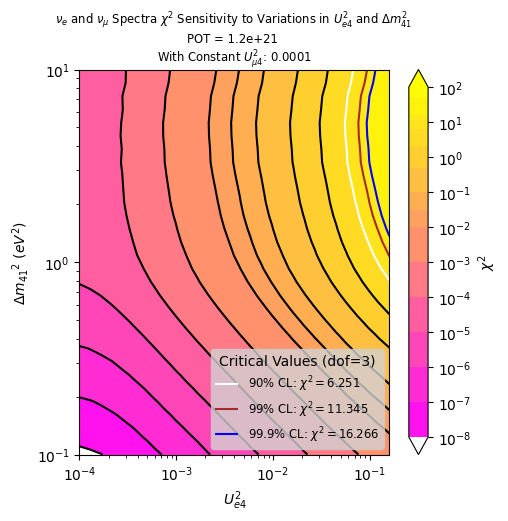

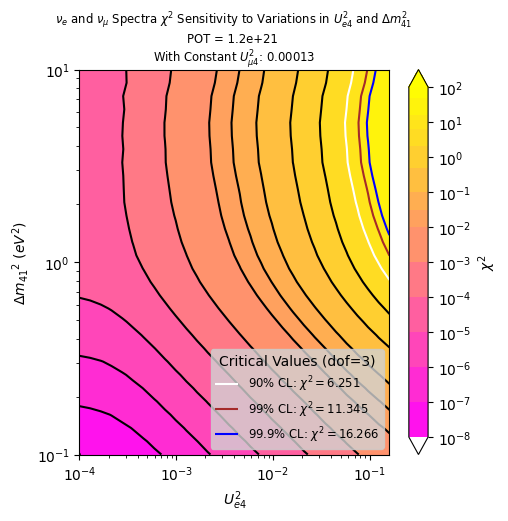

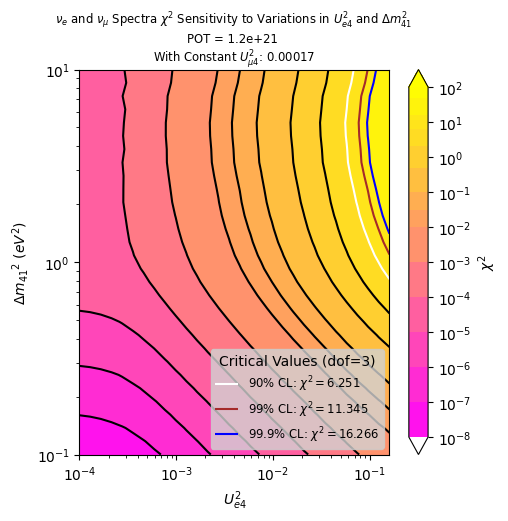

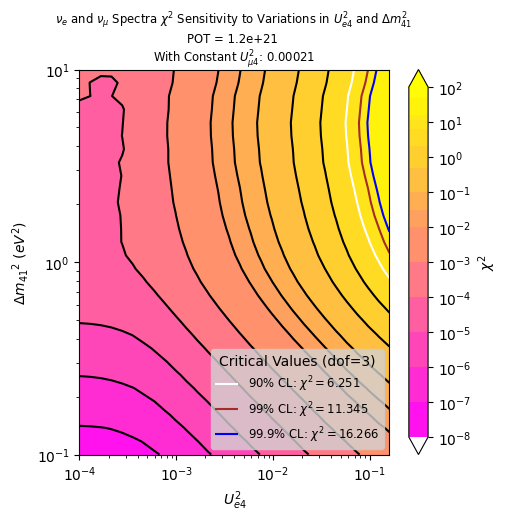

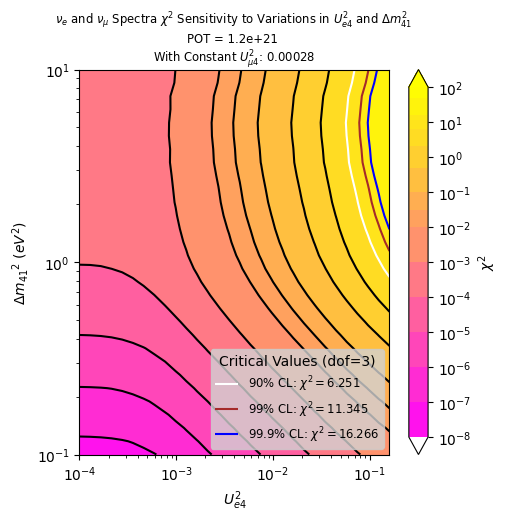

...

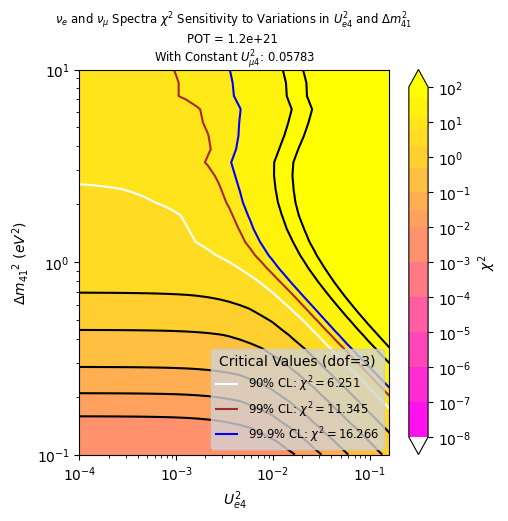

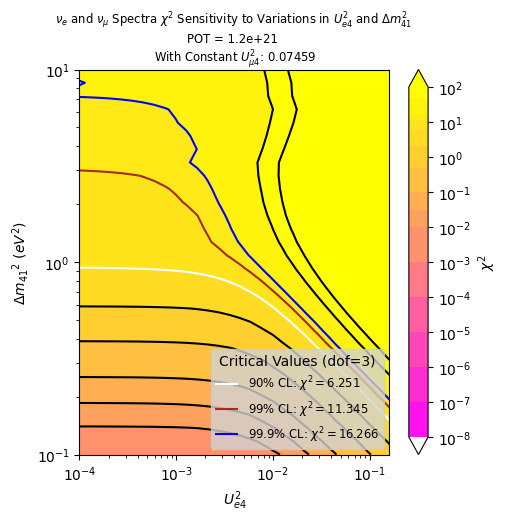

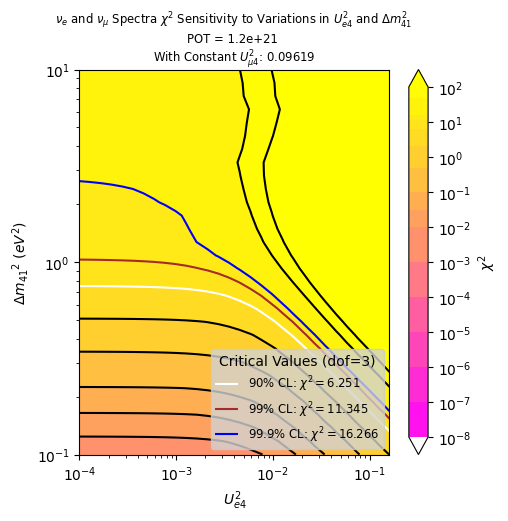

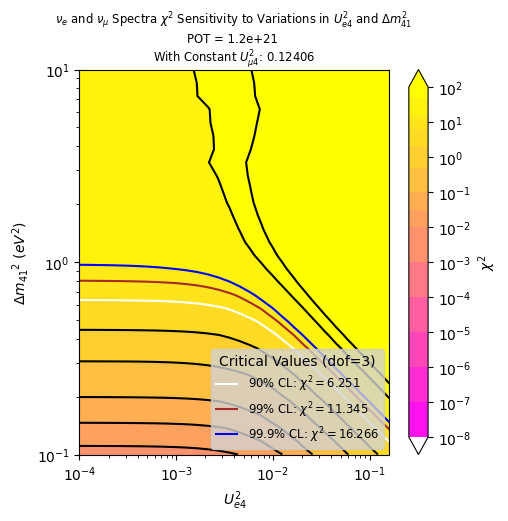

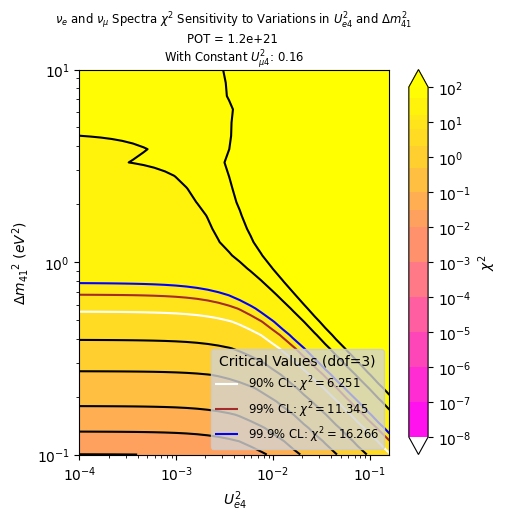

In [19]:
#make gif
for i in range(Um4s.shape[0]):
    plt.figure(figsize=(5,5))
    plt.contourf(Ue4s**2,deltam2s,chi2_3d_with_numu[:,:,i],extend="both", norm="log",levels=[1e-8,1e-7,1e-6,1e-5,1e-4,1e-3,1e-2,0.03,0.1, 0.5,2,cl_90,cl_99,cl_999,50,100], cmap="spring")#, colors=["red","orange","yellow","green","blue","purple","pink"])
    plt.yscale("log")
    plt.xscale("log")
    cbar = plt.colorbar(label="$\chi^2$")
    cbar.set_ticks([1e-8,1e-7,1e-6,1e-5,1e-4,1e-3,0.01,0.1,1,10,100])

    CL = plt.contour(Ue4s**2,deltam2s, chi2_3d_with_numu[:,:,i], norm="linear", levels=[0.01, 0.03, 0.1, 0.5,2], colors="black")
    #manual_locations = [(0.1,0.1),(0.41, 0.1), (0.37,0.2), (0.33, 0.3),(0.29, 0.4)]
    #plt.clabel(CL, inline=True, manual = manual_locations)
    CL1 = plt.contour(Ue4s**2,deltam2s, chi2_3d_with_numu[:,:,i], norm="log", levels=[50,100], colors="black")
    #manual_locations1 = [(0.4,3)]
    #plt.clabel(CL1, inline=True, manual = manual_locations1)
    CL2 = plt.contour(Ue4s**2,deltam2s, chi2_3d_with_numu[:,:,i], norm="log", levels=[cl_90, cl_99, cl_999], colors=["white","brown","blue"])
    critical_colors,critical_labels = CL2.legend_elements()
    #manual_locations2 = [(0.25,1),(0.25, 1.5),(0.25, 3)]
    #plt.clabel(CL2, inline=True, manual = manual_locations2)
    CL3 = plt.contour(Ue4s**2,deltam2s, chi2_3d_with_numu[:,:,i], norm="linear", levels=[1e-8,1e-7,1e-6,1e-5,1e-4,1e-3], colors="black")
    #manual_locations3 = [(0.04, 0.15)]
    #plt.clabel(CL3, inline=True, manual = manual_locations3)
    
    plt.xlabel("$U_{e4}^2$")
    plt.ylabel("$\\Delta{m_{41}}^2$ $(eV^2)$")
    plt.title("$\\nu_{e}$ and $\\nu_{\mu}$ Spectra $\chi^2$ Sensitivity to Variations in $U_{e4}^2$ and $\\Delta{m^2_{41}}$ \nPOT = 1.2e+21 \nWith Constant $U_{\\mu4}^2$: " + str(round(Um4s[i]**2,5)), fontsize="small")
    plt.legend(critical_colors, ["90% CL: $\chi^2=$"+str(cl_90), "99% CL: $\chi^2=$"+str(cl_99), "99.9% CL: $\chi^2=$"+str(cl_999)], loc="lower right", facecolor="lightgray", title="Critical Values (dof="+str(dof)+")", fontsize="small")
    

    name = "Nue_and_Numu_chi2/fig"+str(i)
    #plt.savefig(name, format="png", bbox_inches="tight")
    plt.show()
    plt.close()
    
    


In [ ]:
#combine the 2d contour plots into a single gif
k = []

for i in range(Um4s.shape[0]):
    name = "Nue_and_Numu_chi2/fig" + str(i)
    k.append(mpim.imread(name))
    
    

# Create the figure and axes objects
fig, ax = plt.subplots()

# Set the initial image
im = ax.imshow(k[0], animated=True)

def update(i):
    im.set_array(k[i])
    return im, 

# Create the animation object
animation_fig = animation.FuncAnimation(fig, update, frames=len(k), interval=200, blit=True,repeat_delay=10,)

# Show the animation
plt.show()

animation_fig.save("Nue_and_Numu_chi2_sensitivity.gif")

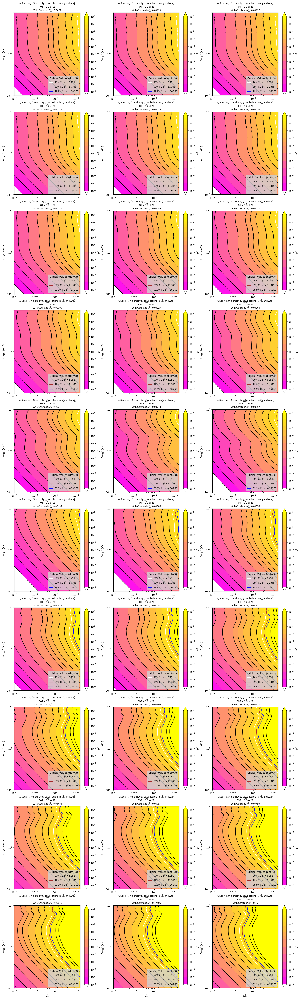

In [179]:
# make contour plots in U_e4 and deltam_41 plane 
# **ONLY Nue plot
plt.figure(figsize=(20,70))
for i in range(Um4s.shape[0]):
    
    plt.subplot(10,3,i+1)
    plt.contourf(Ue4s**2,deltam2s,chi2_3d_only_nue[:,:,i],extend="both", norm="log",levels=[1e-8,1e-7,1e-6,1e-5,1e-4,1e-3,1e-2,0.03,0.1, 0.5,2,cl_90,cl_99,cl_999,50,100], cmap="spring")#, colors=["red","orange","yellow","green","blue","purple","pink"])
    plt.yscale("log")
    plt.xscale("log")
    cbar = plt.colorbar(label="$\chi^2$")
    cbar.set_ticks([1e-8,1e-7,1e-6,1e-5,1e-4,1e-3,0.01,0.1,1,10,100])

    CL = plt.contour(Ue4s**2,deltam2s, chi2_3d_only_nue[:,:,i], norm="linear", levels=[0.01, 0.03, 0.1, 0.5,2], colors="black")
    #manual_locations = [(0.1,0.1),(0.41, 0.1), (0.37,0.2), (0.33, 0.3),(0.29, 0.4)]
    #plt.clabel(CL, inline=True, manual = manual_locations)
    CL1 = plt.contour(Ue4s**2,deltam2s, chi2_3d_only_nue[:,:,i], norm="log", levels=[50,100], colors="black")
    #manual_locations1 = [(0.4,3)]
    #plt.clabel(CL1, inline=True, manual = manual_locations1)
    CL2 = plt.contour(Ue4s**2,deltam2s, chi2_3d_only_nue[:,:,i], norm="log", levels=[cl_90, cl_99, cl_999], colors=["white","brown","blue"])
    critical_colors,critical_labels = CL2.legend_elements()
    #manual_locations2 = [(0.25,1),(0.25, 1.5),(0.25, 3)]
    #plt.clabel(CL2, inline=True, manual = manual_locations2)
    CL3 = plt.contour(Ue4s**2,deltam2s, chi2_3d_only_nue[:,:,i], norm="linear", levels=[1e-8,1e-7,1e-6,1e-5,1e-4,1e-3], colors="black")
    #manual_locations3 = [(0.04, 0.15)]
    #plt.clabel(CL3, inline=True, manual = manual_locations3)
    
    plt.xlabel("$U_{e4}^2$")
    plt.ylabel("$\\Delta{m_{41}}^2$ $(eV^2)$")
    plt.title("$\\nu_{e}$ Spectra $\chi^2$ Sensitivity to Variations in $U_{e4}^2$ and $\\Delta{m^2_{41}}$ \nPOT = 1.2e+21 \nWith Constant $U_{\\mu4}^2$: " + str(round(Um4s[i]**2,5)), fontsize="small")
    plt.legend(critical_colors, ["90% CL: $\chi^2=$"+str(cl_90), "99% CL: $\chi^2=$"+str(cl_99), "99.9% CL: $\chi^2=$"+str(cl_999)], loc="lower right", facecolor="lightgray", title="Critical Values (dof="+str(dof)+")", fontsize="small")

    #if (i==17):
        #plt.scatter(0.02**2,5, color="red", marker="X")
    
    

In [180]:
# #make gif for nue only
# for i in range(Um4s.shape[0]):
#     plt.figure(figsize=(5,5))
#     plt.contourf(Ue4s**2,deltam2s,chi2_3d_only_nue[:,:,i],extend="both", norm="log",levels=[1e-8,1e-7,1e-6,1e-5,1e-4,1e-3,1e-2,0.03,0.1, 0.5,2,cl_90,cl_99,cl_999,50,100], cmap="spring")#, colors=["red","orange","yellow","green","blue","purple","pink"])
#     plt.yscale("log")
#     plt.xscale("log")
#     cbar = plt.colorbar(label="$\chi^2$")
#     cbar.set_ticks([1e-8,1e-7,1e-6,1e-5,1e-4,1e-3,0.01,0.1,1,10,100])

#     CL = plt.contour(Ue4s**2,deltam2s, chi2_3d_only_nue[:,:,i], norm="linear", levels=[0.01, 0.03, 0.1, 0.5,2], colors="black")
#     #manual_locations = [(0.1,0.1),(0.41, 0.1), (0.37,0.2), (0.33, 0.3),(0.29, 0.4)]
#     #plt.clabel(CL, inline=True, manual = manual_locations)
#     CL1 = plt.contour(Ue4s**2,deltam2s, chi2_3d_only_nue[:,:,i], norm="log", levels=[50,100], colors="black")
#     #manual_locations1 = [(0.4,3)]
#     #plt.clabel(CL1, inline=True, manual = manual_locations1)
#     CL2 = plt.contour(Ue4s**2,deltam2s, chi2_3d_only_nue[:,:,i], norm="log", levels=[cl_90, cl_99, cl_999], colors=["white","brown","blue"])
#     critical_colors,critical_labels = CL2.legend_elements()
#     #manual_locations2 = [(0.25,1),(0.25, 1.5),(0.25, 3)]
#     #plt.clabel(CL2, inline=True, manual = manual_locations2)
#     CL3 = plt.contour(Ue4s**2,deltam2s, chi2_3d_only_nue[:,:,i], norm="linear", levels=[1e-8,1e-7,1e-6,1e-5,1e-4,1e-3], colors="black")
#     #manual_locations3 = [(0.04, 0.15)]
#     #plt.clabel(CL3, inline=True, manual = manual_locations3)
    
#     plt.xlabel("$U_{e4}^2$")
#     plt.ylabel("$\\Delta{m_{41}}^2$ $(eV^2)$")
#     plt.title("$\\nu_{e}$ Spectra $\chi^2$ Sensitivity to Variations in $U_{e4}^2$ and $\\Delta{m^2_{41}}$ \nPOT = 1.2e+21 \nWith Constant $U_{\\mu4}^2$: " + str(round(Um4s[i]**2,5)), fontsize="small")
#     plt.legend(critical_colors, ["90% CL: $\chi^2=$"+str(cl_90), "99% CL: $\chi^2=$"+str(cl_99), "99.9% CL: $\chi^2=$"+str(cl_999)], loc="lower right", facecolor="lightgray", title="Critical Values (dof="+str(dof)+")", fontsize="small")

#     name = "Nue_v1/fig"+str(i)
#     plt.savefig(name, format="png", bbox_inches="tight")
#     plt.close()
    
    
# #combine the 2d contour plots into a single gif
# k = []

# for i in range(Um4s.shape[0]):
#     name = "Nue_v1/fig" + str(i)
#     k.append(mpim.imread(name))
    
    

# # Create the figure and axes objects
# fig, ax = plt.subplots()

# # Set the initial image
# im = ax.imshow(k[0], animated=True)

# def update(i):
#     im.set_array(k[i])
#     return im, 

# # Create the animation object
# animation_fig = animation.FuncAnimation(fig, update, frames=len(k), interval=200, blit=True,repeat_delay=10,)

# # Show the animation
# plt.show()

# animation_fig.save("Nue_Only_chi2_sensitivity.gif")

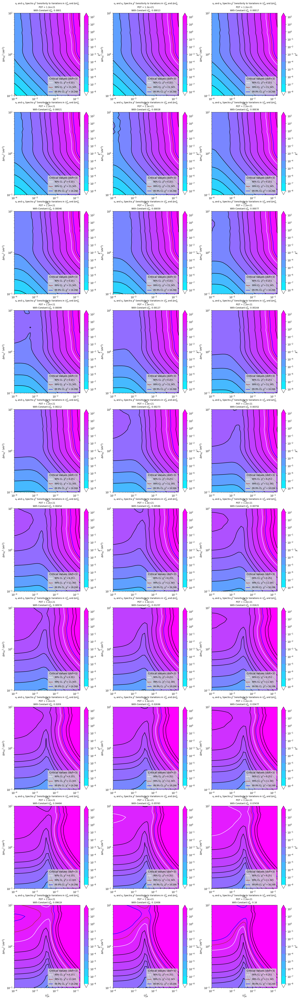

In [181]:
#make contour plots in U_m4 and deltm_41 plane
plt.figure(figsize=(20,70))
for i in range(Ue4s.shape[0]):
    
    plt.subplot(10,3,i+1)
    plt.contourf(Um4s**2,deltam2s,chi2_3d_with_numu[:,i,:],extend="both", norm="log",levels=[1e-8,1e-7,1e-6, 0.00001,0.0001,0.001,0.01,0.03,0.1, 0.5,2,cl_90,cl_99,cl_999,50,100], cmap="cool")#, colors=["red","orange","yellow","green","blue","purple","pink"])
    plt.yscale("log")
    plt.xscale("log")
    cbar = plt.colorbar(label="$\chi^2$")
    cbar.set_ticks([1e-8,1e-7,1e-6, 0.00001, 0.0001, 0.001,0.01,0.1,1,10,100])

    CL = plt.contour(Um4s**2,deltam2s, chi2_3d_with_numu[:,i,:], norm="linear", levels=[0.001,0.01, 0.03, 0.1, 0.5,2], colors="black")
    #manual_locations = [(0.1,0.1),(0.41, 0.1), (0.37,0.2), (0.33, 0.3),(0.29, 0.4)]
    #plt.clabel(CL, inline=True, manual = manual_locations)
    CL1 = plt.contour(Um4s**2,deltam2s, chi2_3d_with_numu[:,i,:], norm="log", levels=[50,100], colors="black")
    #manual_locations1 = [(0.4,3)]
    #plt.clabel(CL1, inline=True, manual = manual_locations1)
    CL2 = plt.contour(Um4s**2,deltam2s, chi2_3d_with_numu[:,i,:], norm="log", levels=[cl_90,cl_99,cl_999], colors=["white","brown","blue"])
    critical_colors,critical_labels = CL2.legend_elements()
    #manual_locations2 = [(0.25,1),(0.25, 1.5),(0.25, 3)]
    #plt.clabel(CL2, inline=True, manual = manual_locations2)
    CL3 = plt.contour(Um4s**2,deltam2s, chi2_3d_with_numu[:,i,:], norm="linear", levels=[0.0001], colors="black")
    #manual_locations3 = [(0.04, 0.15)]
    #plt.clabel(CL3, inline=True, manual = manual_locations3)
    CL3 = plt.contour(Um4s**2,deltam2s, chi2_3d_with_numu[:,i,:], norm="linear", levels=[1e-8,1e-7,1e-6, 0.00001], colors="black")
    #manual_locations3 = []
    #plt.clabel(CL3, inline=True, manual = manual_locations3)
    
    plt.xlabel("$U_{\\mu4}^2$")
    plt.ylabel("$\\Delta{m_{41}}^2$ $(eV^2)$")
    plt.title("$\\nu_{e}$ and $\\nu_{\mu}$ Spectra $\chi^2$ Sensitivity to Variations in $U_{\\mu4}^2$ and $\\Delta{m^2_{41}}$ \nPOT = 1.2e+21 \nWith Constant $U_{e4}^2$: " + str(round(Ue4s[i]**2,5)), fontsize="small")
    plt.legend(critical_colors, ["90% CL: $\chi^2=$"+str(cl_90), "99% CL: $\chi^2=$"+str(cl_99), "99.9% CL: $\chi^2=$"+str(cl_999)], loc="lower right", facecolor="lightgray", title="Critical Values (dof="+str(dof)+")", fontsize="small")

       

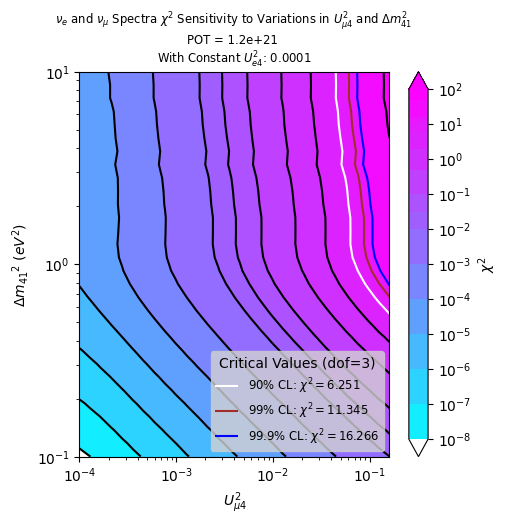

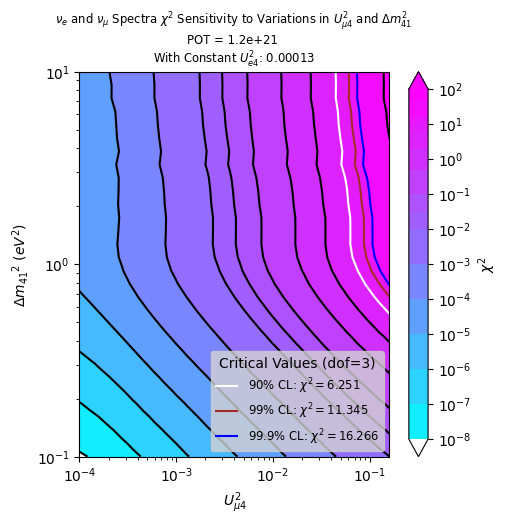

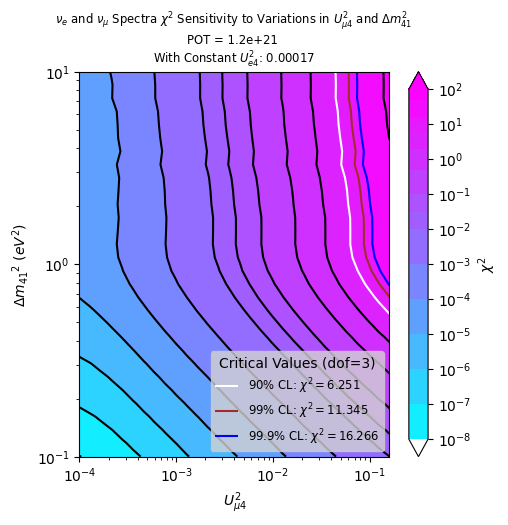

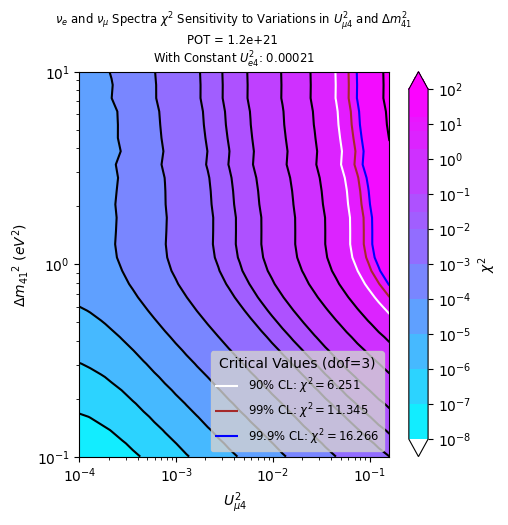

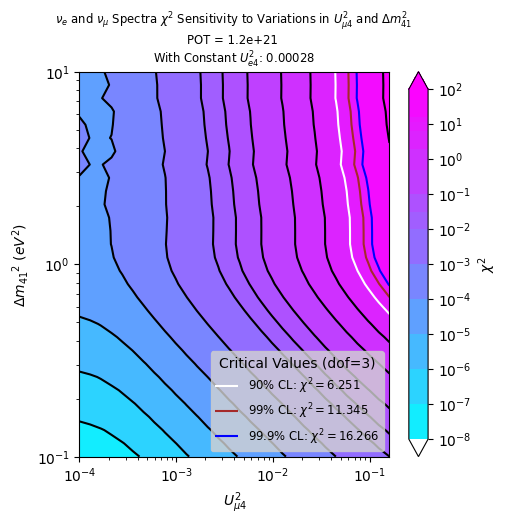

...

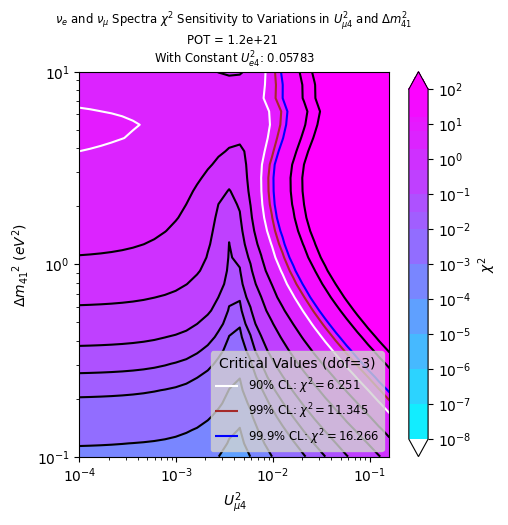

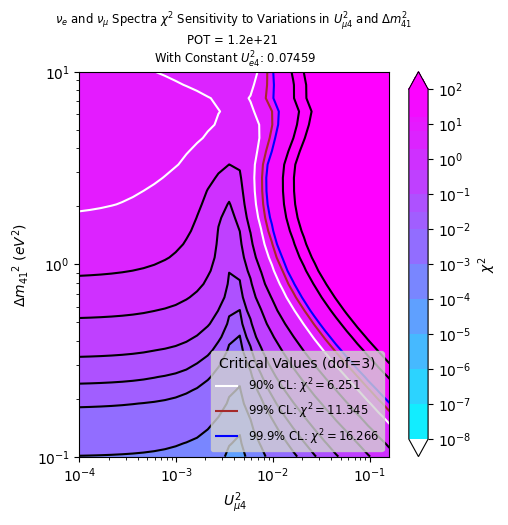

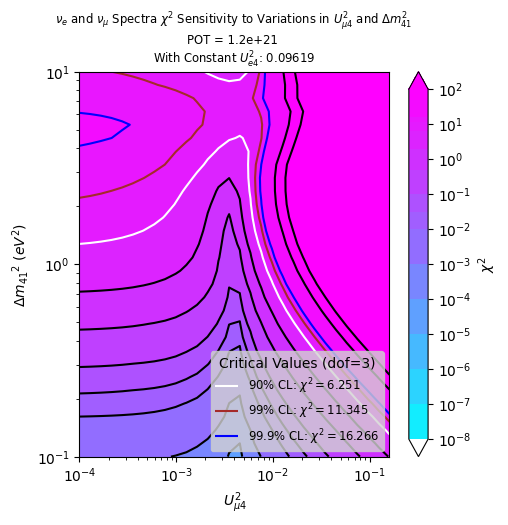

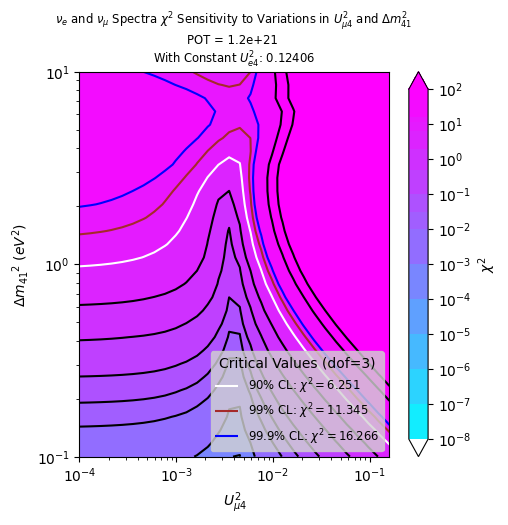

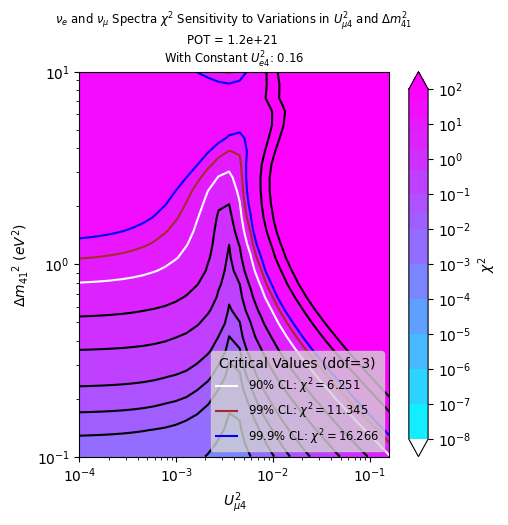

In [20]:
#make gif
for i in range(Ue4s.shape[0]):
    plt.figure(figsize=(5,5))
    plt.contourf(Um4s**2,deltam2s,chi2_3d_with_numu[:,i,:],extend="both", norm="log",levels=[1e-8,1e-7,1e-6, 0.00001,0.0001,0.001,0.01,0.03,0.1, 0.5,2,cl_90,cl_99,cl_999,50,100], cmap="cool")#, colors=["red","orange","yellow","green","blue","purple","pink"])
    plt.yscale("log")
    plt.xscale("log")
    cbar = plt.colorbar(label="$\chi^2$")
    cbar.set_ticks([1e-8,1e-7,1e-6, 0.00001, 0.0001, 0.001,0.01,0.1,1,10,100])

    CL = plt.contour(Um4s**2,deltam2s, chi2_3d_with_numu[:,i,:], norm="linear", levels=[0.001,0.01, 0.03, 0.1, 0.5,2], colors="black")
    #manual_locations = [(0.1,0.1),(0.41, 0.1), (0.37,0.2), (0.33, 0.3),(0.29, 0.4)]
    #plt.clabel(CL, inline=True, manual = manual_locations)
    CL1 = plt.contour(Um4s**2,deltam2s, chi2_3d_with_numu[:,i,:], norm="log", levels=[50,100], colors="black")
    #manual_locations1 = [(0.4,3)]
    #plt.clabel(CL1, inline=True, manual = manual_locations1)
    CL2 = plt.contour(Um4s**2,deltam2s, chi2_3d_with_numu[:,i,:], norm="log", levels=[cl_90,cl_99,cl_999], colors=["white","brown","blue"])
    critical_colors,critical_labels = CL2.legend_elements()
    #manual_locations2 = [(0.25,1),(0.25, 1.5),(0.25, 3)]
    #plt.clabel(CL2, inline=True, manual = manual_locations2)
    CL3 = plt.contour(Um4s**2,deltam2s, chi2_3d_with_numu[:,i,:], norm="linear", levels=[0.0001], colors="black")
    #manual_locations3 = [(0.04, 0.15)]
    #plt.clabel(CL3, inline=True, manual = manual_locations3)
    CL3 = plt.contour(Um4s**2,deltam2s, chi2_3d_with_numu[:,i,:], norm="linear", levels=[1e-8,1e-7,1e-6, 0.00001], colors="black")
    #manual_locations3 = []
    #plt.clabel(CL3, inline=True, manual = manual_locations3)
    
    plt.xlabel("$U_{\\mu4}^2$")
    plt.ylabel("$\\Delta{m_{41}}^2$ $(eV^2)$")
    plt.title("$\\nu_{e}$ and $\\nu_{\mu}$ Spectra $\chi^2$ Sensitivity to Variations in $U_{\\mu4}^2$ and $\\Delta{m^2_{41}}$ \nPOT = 1.2e+21 \nWith Constant $U_{e4}^2$: " + str(round(Ue4s[i]**2,5)), fontsize="small")
    plt.legend(critical_colors, ["90% CL: $\chi^2=$"+str(cl_90), "99% CL: $\chi^2=$"+str(cl_99), "99.9% CL: $\chi^2=$"+str(cl_999)], loc="lower right", facecolor="lightgray", title="Critical Values (dof="+str(dof)+")", fontsize="small")

    name = "Nue_and_Numu_chi2_2/fig"+str(i)
    #plt.savefig(name, format="png", bbox_inches="tight")
    plt.show()
    plt.close()
    

In [ ]:
#combine the 2d contour plots into a single gif
k = []

for i in range(Ue4s.shape[0]):
    name = "Nue_and_Numu_chi2_2/fig" + str(i)
    k.append(mpim.imread(name))
    

# Create the figure and axes objects
fig, ax = plt.subplots()

# Set the initial image
im = ax.imshow(k[0], animated=True)

def update(i):
    im.set_array(k[i])
    return im, 

# Create the animation object
animation_fig = animation.FuncAnimation(fig, update, frames=len(k), interval=200, blit=True,repeat_delay=10,)

# Show the animation
plt.show()

animation_fig.save("Nue_and_Numu_v2_chi2_sensitivity.gif")

Example data using 3 bins: $Data_{expect} = \left[ {\begin{array}{ccc}
   10 & 2 & 6\\
  \end{array} } \right]$ and $Data_{observe} = \left[ {\begin{array}{ccc}
   20 & 3 & 8\\
  \end{array} } \right]$
  
Then, the fractional covariance matrix will be the linear combination of the 4 following matricies:
The fractional statistical error matrix, with elements $\sigma_i^2 = N_{i,expect}/N^2_{i,expect}$

$K_{statistical} = \left[ {\begin{array}{ccc}
   10/10^2 & 0 & 0 \\
   0 & 2/2^2 & 0\\
   0 & 0 & 6/6^2\\
  \end{array} } \right] =  \left[ {\begin{array}{ccc}
   0.1 & 0 & 0 \\
   0 & 0.5 & 0\\
   0 & 0 & 0.16667\\
  \end{array} } \right]$
  
The Flux systematic error, with elements $cov_{ij}=\sigma_{sys,i}*\sigma_{sys,j}*\rho_{ij}$, where $\sigma_{sys,i} = 0.15$ and $\rho_{ij} = 0.5$

$K_{flux} = \left[ {\begin{array}{ccc}
   0.15*0.15*1 & 0.15*0.15*0.5 & 0.15*0.15*0.5\\
   0.15*0.15*0.5 & 0.15*0.15*1 & 0.15*0.15*0.5\\
   0.15*0.15*0.5 & 0.15*0.15*0.5 & 0.15*0.15*1\\
  \end{array} } \right] = \left[ {\begin{array}{ccc}
   0.0225 & 0.01125 & 0.01125\\
   0.01125 & 0.0225 & 0.01125\\
   0.01125 & 0.01125 & 0.0225\\
  \end{array} } \right]$
  
The Cross-section systematic error, with elements $cov_{ij}=\sigma_{sys,i}*\sigma_{sys,j}*\rho_{ij}$, where $\sigma_{sys,i} = 0.2$ and $\rho_{ij} = 1$

$K_{cross-section} = \left[ {\begin{array}{ccc}
   0.2*0.2*1 & 0.2*0.2*1 & 0.2*0.2*1\\
   0.2*0.2*1 & 0.2*0.2*1 & 0.2*0.2*1\\
   0.2*0.2*1 & 0.2*0.2*1 & 0.2*0.2*1\\
  \end{array} } \right] = \left[ {\begin{array}{ccc}
   0.04 & 0.04 & 0.04\\
   0.04 & 0.04 & 0.04\\
   0.04 & 0.04 & 0.04\\
  \end{array} } \right]$
  
The Detection systematic error, with elements $cov_{ij}=\sigma_{sys,i}*\sigma_{sys,j}*\rho_{ij}$, where $\sigma_{sys,i} = 0.03$ and $\rho_{ij} = 0$

$K_{detection} = \left[ {\begin{array}{ccc}
   0.03*0.03*1 & 0.03*0.03*0 & 0.03*0.03*0\\
   0.03*0.03*0 & 0.03*0.03*1 & 0.03*0.03*0\\
   0.03*0.03*0 & 0.03*0.03*0 & 0.03*0.03*1\\
  \end{array} } \right] = \left[ {\begin{array}{ccc}
   0.0009 & 0 & 0\\
   0 & 0.0009 & 0\\
   0 & 0 & 0.0009\\
  \end{array} } \right]$
  
Then, the final fractional covariance matrix is: $K = K_{statistical} + K_{flux} + K_{cross-section} + K_{detection} = \left[ {\begin{array}{ccc}
   0.1634 & 0.05125 & 0.05125\\
   0.05125 & 0.5634 & 0.05125\\
   0.05125 & 0.05125 & 0.23006667\\
  \end{array} } \right]$
  
Then, we need to turn the fractional covariance matrix K into the full covariance matrix M by multiplying each element in K by the total events in each bin i and j: $K_{ij}*N_{i,expect}*N_{j,expect}$

$M = \left[ {\begin{array}{ccc}
   0.1634*10*10 & 0.05125*2*10 & 0.05125*6*10\\
   0.05125*2*10 & 0.5634*2*2 & 0.05125*2*6\\
   0.05125*6*10 & 0.05125*2*6 & 0.23006667*6*6\\
  \end{array} } \right] = \left[ {\begin{array}{ccc}
   16.34 & 1.025 & 3.075\\
   1.025 & 2.2536 & 0.651\\
   3.075 & 0.615 & 8.28240012\\
  \end{array} } \right]$
  
  
  
And the inverse covariance matrix is: $M^{-1} = \left[ {\begin{array}{ccc}
    0.06706507 & -0.0241985 & -0.02310236\\
    -0.0241985 & 0.46164344 & -0.02529464\\
    -0.02310236 & -0.02529464 & 0.13119337\\
  \end{array} } \right]$
  
Then, once we've found the total covariance matrix, we can calculate the $\chi^2$ value for our observed data: $\chi^2 = \sum_{i}^{N}{\sum_{j}^N{(Observed_i - Expected_i)*M^{-1}_{ij}*(Observed_j - Expected_j)}}$

Going through the summation each element at a time, we have the 9 calculations below:
- $(Observe_1 - Expect_1) * M^{-1}_{11} * (Observe_1 - Expect_1) = (20-10)*0.06706507*(20-10) = 6.706507$
- $(Observe_1 - Expect_1) * M^{-1}_{12} * (Observe_2 - Expect_2) = (20-10)*-0.0241985*(3-2) = -0.241985$
- $(Observe_1 - Expect_1) * M^{-1}_{13} * (Observe_3 - Expect_3) = (20-10)*-0.02310236*(8-6) = -0.4620472$
- $(Observe_2 - Expect_2) * M^{-1}_{21} * (Observe_1 - Expect_1) = (3-2)*-0.0241985*(20-10) = -0.241985$
- $(Observe_2 - Expect_2) * M^{-1}_{22} * (Observe_2 - Expect_2) = (3-2)*0.46164344*(3-2) = 0.46164344$
- $(Observe_2 - Expect_2) * M^{-1}_{23} * (Observe_3 - Expect_3) = (3-2)*-0.02529464*(8-6) = -0.05058928$
- $(Observe_3 - Expect_3) * M^{-1}_{31} * (Observe_1 - Expect_1) = (8-6)*-0.02310236*(20-10) = -0.4620472$
- $(Observe_3 - Expect_3) * M^{-1}_{32} * (Observe_2 - Expect_2) = (8-6)*-0.02529464*(3-2) = -0.05058928$
- $(Observe_3 - Expect_3) * M^{-1}_{33} * (Observe_3 - Expect_3) = (8-6)*0.13119337*(8-6) = 0.52477348$

So, the sum is then: $\chi^2 = 6.706507 + -0.241985 + -0.4620472 + -0.241985 + 0.46164344 + -0.05058928 + -0.4620472 + -0.05058928 + 0.52477348 = 6.18368096$

In [25]:
chi2(np.array([10,2,6]), np.array([20,3,8]), error="correlated")

6.18368073936043

$\Delta{m_{41}^2}$


$

In [26]:
#try plotting in 2d as deltam2 vs sin2(2theta_mue)



In [71]:
deltam2s = np.logspace(np.log10(0.1),np.log10(10),10, base=10)

#if I want sin2_mue = [1e-5, 0.1] and sin2_ee = [0,0.5]
#sin2(2*theta_mue) = sin2(2*theta_14)sin2(theta_24) = 4 * (U_m4)^2 * (U_e4)^2
#sin2(2*theta_ee) = sin2(2*theta_14) = 4 * (1-(U_e4)^2) * (U_e4)^2

Ue4s = np.logspace(np.log10(0.01), np.log10(0.4), 10, base=10)
Um4s = np.logspace(np.log10(0.01), np.log10(0.4), 10, base=10)



#try a 3D plot
chi2_3d_with_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
chi2_3d_only_nue = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
chi2_3d_only_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))

sin2s_mue =  np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
sin2s_list = []
deltams_list = []
chi2_list = []

chi2_2d = np.zeros((deltam2s.shape[0], Ue4s.shape[0]*Um4s.shape[0]))
sin2s_no_repeat = np.zeros((Ue4s.shape[0]*Um4s.shape[0]))

start= time.time()
for i in range(deltam2s.shape[0]):
    print("Event i:", str(i))
    t = time.time() - start
    print("Time elapsed in seconds since starting cell:", str(t))
    
    n = 0
    for j in range(Ue4s.shape[0]):
        for k in range(Um4s.shape[0]):
            nue_chi2, numu_chi2, total_chi2 = osc_chi2([deltam2s[i], Ue4s[j], Um4s[k]], intrin_e, osc_e, cc_mu)
            chi2_3d_with_numu[i][j][k] = total_chi2
            chi2_3d_only_nue[i][j][k] = nue_chi2
            chi2_3d_only_numu[i][j][k] = numu_chi2
            sin2s_mue[i][j][k] = 4*((Ue4s[j])**2)*((Um4s[k])**2)
            
            chi2_2d[i][n] = total_chi2
            if (i==0):
                sin2s_no_repeat[n] = 4*((Ue4s[j])**2)*((Um4s[k])**2)
            n = n+1
            
            # print("deltam = ", deltam2s[i])
            # print("Ue4 = ", Ue4s[j])
            # print("Um4 = ", Um4s[k])
            # print(4*((Ue4s[j])**2)*((Um4s[k])**2))
            sin2s_list.append(4*((Ue4s[j])**2)*((Um4s[k])**2))
            deltams_list.append(deltam2s[i])
            chi2_list.append(total_chi2)
            #print("Event " + str(i) + "-" + str(j) + "-" + str(k) + " completed")
        #n = n+1
 

Event i: 0
Time elapsed in seconds since starting cell: 0.0004038810729980469
Event i: 1
Time elapsed in seconds since starting cell: 9.339914083480835
Event i: 2
Time elapsed in seconds since starting cell: 18.75821566581726
Event i: 3
Time elapsed in seconds since starting cell: 28.343299388885498
Event i: 4
Time elapsed in seconds since starting cell: 37.894700050354004
Event i: 5
Time elapsed in seconds since starting cell: 47.453287839889526
Event i: 6
Time elapsed in seconds since starting cell: 57.07803988456726
Event i: 7
Time elapsed in seconds since starting cell: 66.78641176223755
Event i: 8
Time elapsed in seconds since starting cell: 76.61864042282104
Event i: 9
Time elapsed in seconds since starting cell: 86.7312924861908


Text(0.5, 1.0, 'Collapsed Parameter Space $\\chi^2$ Sensitivity')

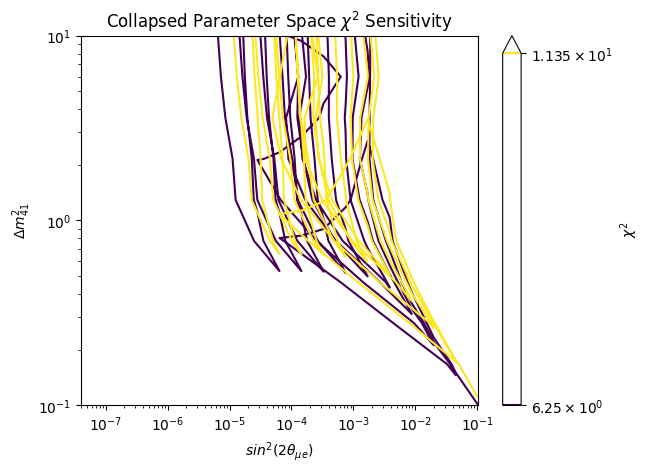

In [153]:
plt.contour(sin2s_no_repeat, deltam2s, chi2_2d, norm="log", levels=[6.25, 11.35], extend="max")
plt.xscale("log")
plt.yscale("log")
plt.colorbar(label="$\\chi^2$")
plt.xlabel("$sin^2(2\\theta_{\mu e})$")
plt.ylabel("$\\Delta{m^2_{41}}$")
plt.title("Collapsed Parameter Space $\chi^2$ Sensitivity")

In [89]:
print(sin2s_list[10], deltams_list[10], chi2_list[10])
print(sin2s_list[1], deltams_list[1], chi2_list[1])

9.079738121229386e-08 0.1 1.3767816059801663e-08
9.079738121229386e-08 0.1 2.7948829342278456e-08
0.0001452758099396702 0.1 0.009910053547950373


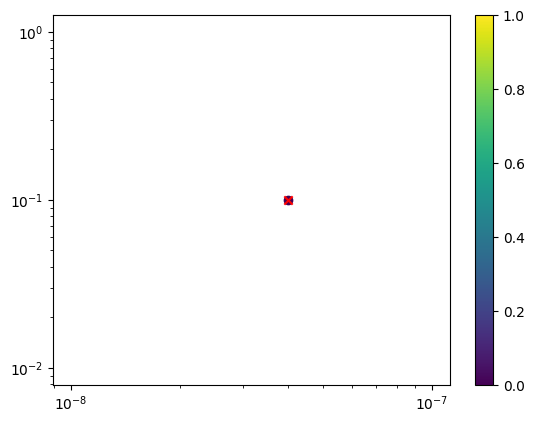

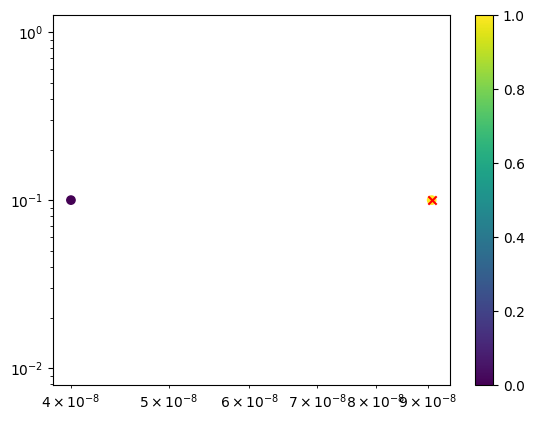

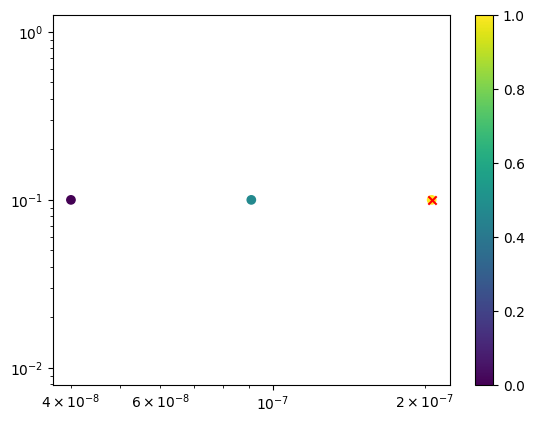

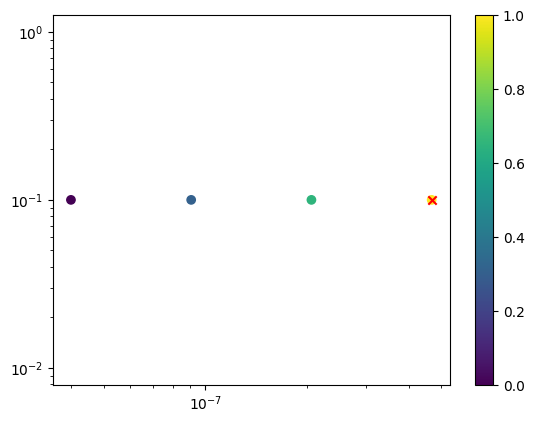

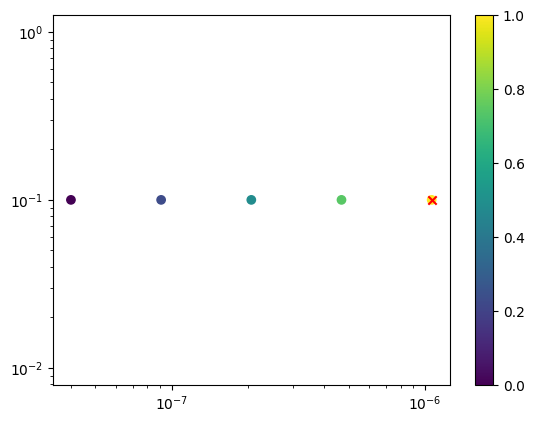

...

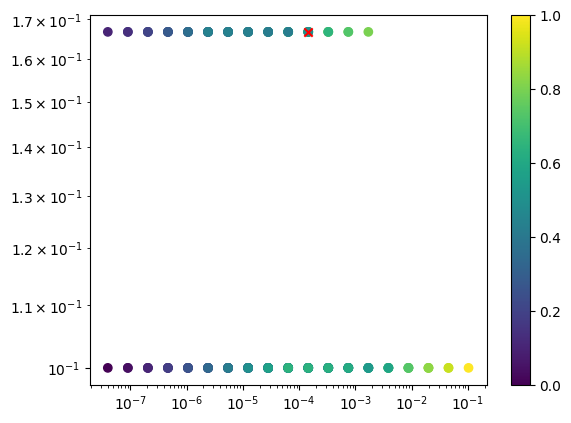

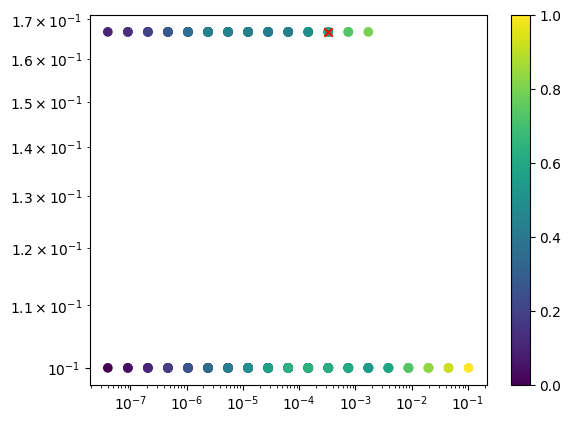

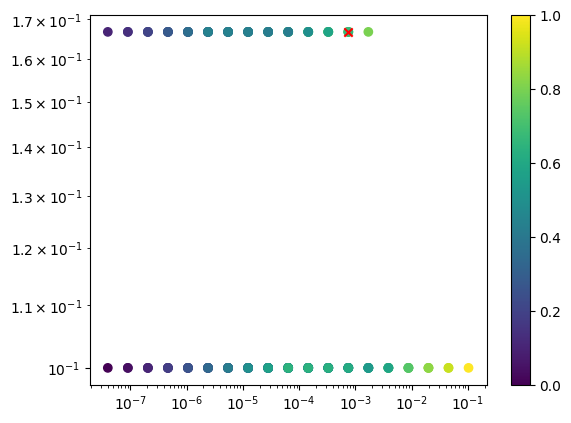

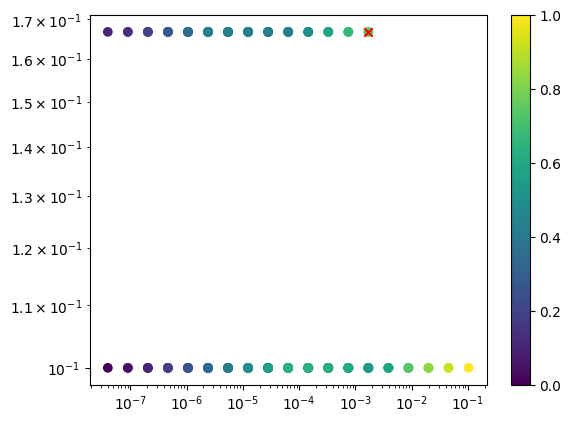

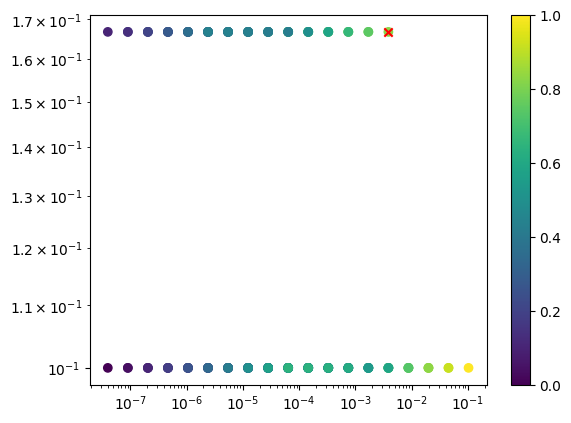

KeyboardInterrupt: 

In [87]:
ass = []
bss = []
css = []


for i in range(len(sin2s_list)):
    ass.append(sin2s_list[i])
    bss.append(deltams_list[i])
    css.append(chi2_list[i])
    plt.scatter(ass,bss, c=css, norm="log")
    plt.scatter(ass[-1],bss[-1],marker="x",color="red")
    plt.xscale("log")
    plt.yscale("log")
    plt.colorbar()
    plt.show()
    


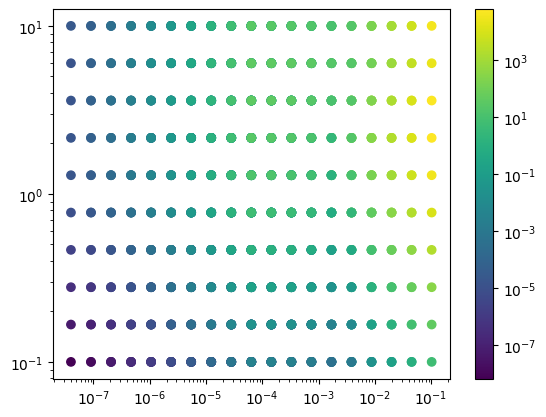

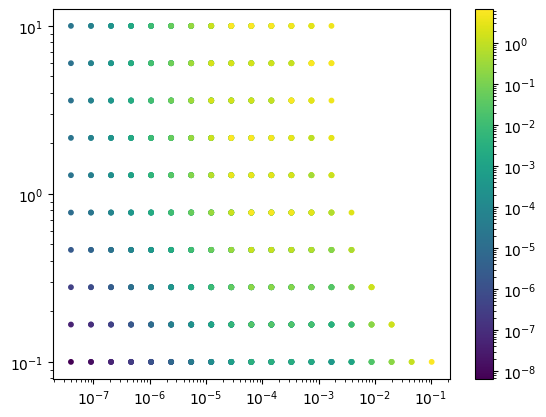

In [104]:
#plt.scatter(sin2s_list, deltams_list, c=chi2_list, norm="log")
plt.scatter(sin2s_list, deltams_list, c=chi2_list, norm="log")
plt.xscale("log")
plt.yscale("log")
plt.colorbar()
plt.show()


low_chi_sin2s = []
low_chi_deltams = []
low_chis = []
for i in range(len(sin2s_list)):
    if (chi2_list[i] < 7):
        low_chi_sin2s.append(sin2s_list[i])
        low_chi_deltams.append(deltams_list[i])
        low_chis.append(chi2_list[i])

plt.scatter(low_chi_sin2s, low_chi_deltams, c=low_chis, norm="log",s=10)
plt.xscale("log")
plt.yscale("log")
plt.colorbar()
plt.show()

In [185]:
# deltam2s = np.logspace(np.log10(0.1),np.log10(10),30, base=10)

# #if I want sin2_mue = [1e-5, 0.1] and sin2_ee = [0,0.5]
# #sin2(2*theta_mue) = sin2(2*theta_14)sin2(theta_24) = 4 * (U_m4)^2 * (U_e4)^2
# #sin2(2*theta_ee) = sin2(2*theta_14) = 4 * (1-(U_e4)^2) * (U_e4)^2

# Ue4s = np.logspace(np.log10(0.01), np.log10(0.4), 30, base=10)
# Um4s = np.logspace(np.log10(0.01), np.log10(0.4), 30, base=10)



# #try a 3D plot
# chi2_3d_with_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# chi2_3d_only_nue = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# chi2_3d_only_numu = np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))

# sin2s_mue =  np.zeros((deltam2s.shape[0],Ue4s.shape[0], Um4s.shape[0]))
# sin2s_list = []
# deltams_list = []
# chi2_list = []

# chi2_2d = np.zeros((deltam2s.shape[0], Ue4s.shape[0]*Um4s.shape[0]))
# sin2s_no_repeat = np.zeros((Ue4s.shape[0]*Um4s.shape[0]))

# start= time.time()
# for i in range(deltam2s.shape[0]):
#     print("Event i:", str(i))
#     t = time.time() - start
#     print("Time elapsed in seconds since starting cell:", str(t))
    
#     n = 0
#     for j in range(Ue4s.shape[0]):
#         for k in range(Um4s.shape[0]):
#             nue_chi2, numu_chi2, total_chi2 = osc_chi2([deltam2s[i], Ue4s[j], Um4s[k]], intrin_e, osc_e, cc_mu)
#             chi2_3d_with_numu[i][j][k] = total_chi2
#             chi2_3d_only_nue[i][j][k] = nue_chi2
#             chi2_3d_only_numu[i][j][k] = numu_chi2
#             sin2s_mue[i][j][k] = 4*((Ue4s[j])**2)*((Um4s[k])**2)
            
#             chi2_2d[i][n] = total_chi2
#             if (i==0):
#                 sin2s_no_repeat[n] = 4*((Ue4s[j])**2)*((Um4s[k])**2)
#             n = n+1
            
#             # print("deltam = ", deltam2s[i])
#             # print("Ue4 = ", Ue4s[j])
#             # print("Um4 = ", Um4s[k])
#             # print(4*((Ue4s[j])**2)*((Um4s[k])**2))
#             sin2s_list.append(4*((Ue4s[j])**2)*((Um4s[k])**2))
#             deltams_list.append(deltam2s[i])
#             chi2_list.append(total_chi2)
#             #print("Event " + str(i) + "-" + str(j) + "-" + str(k) + " completed")
#         #n = n+1

# np.save("sin2s_mue_3d.npy", sin2s_mue)
# np.save("sin2s_list.npy", np.array(sin2s_list))
# np.save("deltams_list.npy", np.array(deltams_list))
# np.save("chi2_list.npy", np.array(chi2_list))
# np.save("chi2_2d_collapsed.npy", chi2_2d)
# np.save("sin2s_no_repeat.npy", sin2s_no_repeat)

Event i: 0
Time elapsed in seconds since starting cell: 0.0004010200500488281
Event i: 1
Time elapsed in seconds since starting cell: 105.09398889541626
Event i: 2
Time elapsed in seconds since starting cell: 210.29186940193176
Event i: 3
Time elapsed in seconds since starting cell: 315.6671669483185
Event i: 4
Time elapsed in seconds since starting cell: 421.4495198726654
Event i: 5
Time elapsed in seconds since starting cell: 513.7226951122284
Event i: 6
Time elapsed in seconds since starting cell: 599.9497168064117
Event i: 7
Time elapsed in seconds since starting cell: 686.9919328689575
Event i: 8
Time elapsed in seconds since starting cell: 773.8099377155304
Event i: 9
Time elapsed in seconds since starting cell: 862.9725861549377
Event i: 10
Time elapsed in seconds since starting cell: 949.291613817215
Event i: 11
Time elapsed in seconds since starting cell: 1035.601478099823
Event i: 12
Time elapsed in seconds since starting cell: 1121.6700415611267
Event i: 13
Time elapsed in s

In [186]:
sin2s_mue =  np.load("sin2s_mue_3d.npy")
sin2s_list = np.load("sin2s_list.npy")
deltams_list = np.load("deltams_list.npy")
chi2_list = np.load("chi2_list.npy")

chi2_2d = np.load("chi2_2d_collapsed.npy")
sin2s_no_repeat = np.load("sin2s_no_repeat.npy")

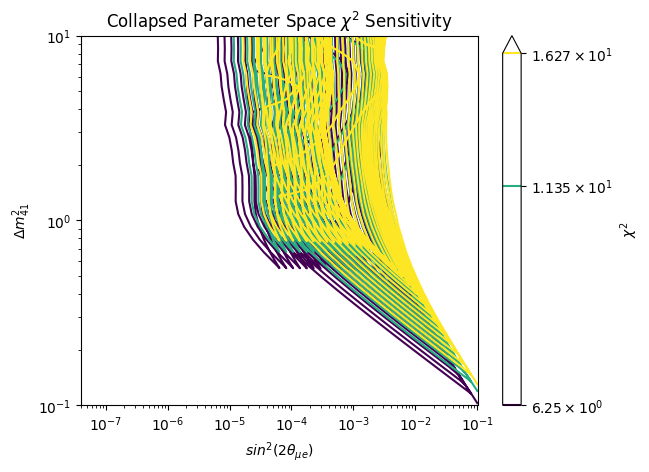

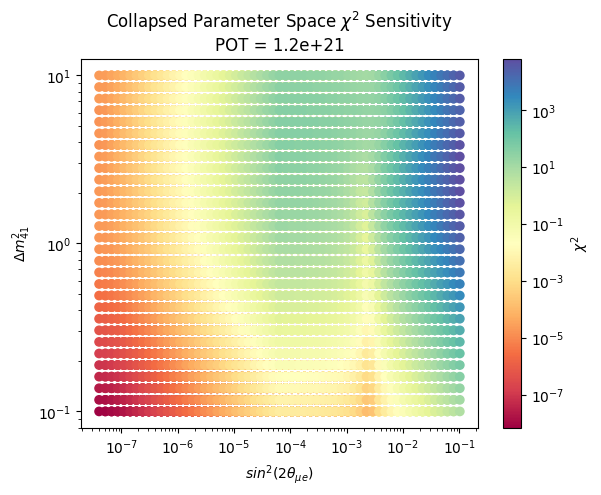

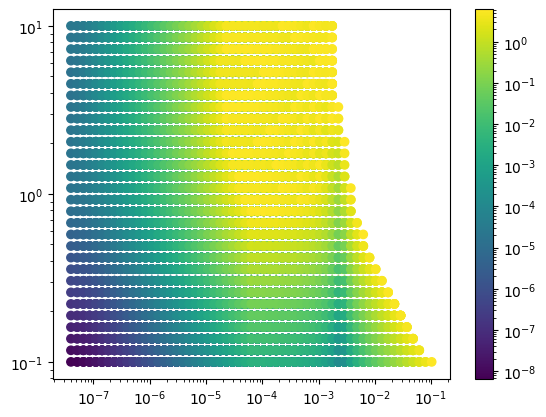

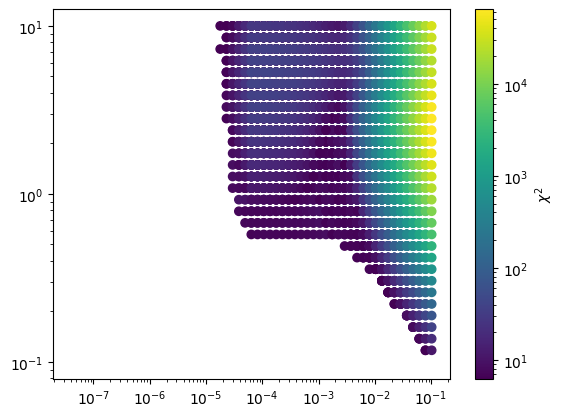

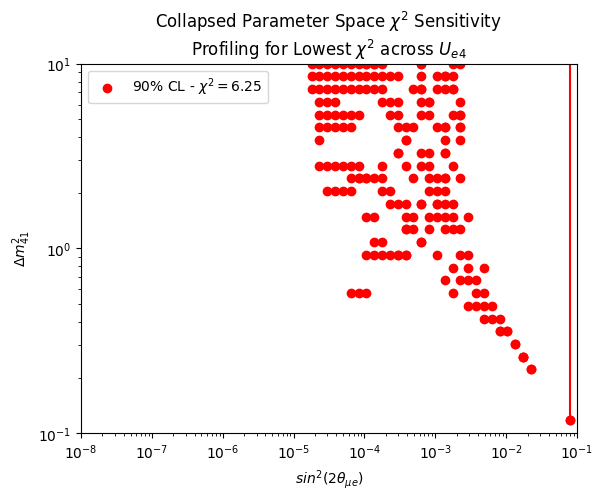

In [284]:
plt.contour(sin2s_no_repeat, deltam2s, chi2_2d, norm="log", levels=[6.25, 11.35,16.27], extend="max")
plt.xscale("log")
plt.yscale("log")
plt.colorbar(label="$\\chi^2$")
plt.xlabel("$sin^2(2\\theta_{\mu e})$")
plt.ylabel("$\\Delta{m^2_{41}}$")
plt.title("Collapsed Parameter Space $\chi^2$ Sensitivity")
plt.show()


plt.scatter(sin2s_list, deltams_list, c=chi2_list, norm="log", cmap="Spectral")
plt.xscale("log")
plt.yscale("log")
plt.colorbar(label="$\chi^2$")
plt.xlabel("$sin^2(2\\theta_{\mu e})$")
plt.ylabel("$\\Delta{m^2_{41}}$")
plt.title("Collapsed Parameter Space $\chi^2$ Sensitivity \nPOT = 1.2e+21")
plt.show()

#plt.scatter(sin2s_list, deltams_list, c=chi2_list, norm="log")

low_chi_sin2s = []
low_chi_deltams = []
low_chis = []
for i in range(len(sin2s_list)):
    if (chi2_list[i] < 6.25):
        low_chi_sin2s.append(sin2s_list[i])
        low_chi_deltams.append(deltams_list[i])
        low_chis.append(chi2_list[i])

plt.scatter(sin2s_list, deltams_list, color="white")
plt.scatter(low_chi_sin2s, low_chi_deltams, c=low_chis, norm="log")
plt.xscale("log")
plt.yscale("log")
plt.colorbar()
plt.show()


high_chi_sin2s = []
high_chi_deltams = []
high_chis = []
for i in range(len(sin2s_list)):
    if (chi2_list[i] > 6.25):
        high_chi_sin2s.append(sin2s_list[i])
        high_chi_deltams.append(deltams_list[i])
        high_chis.append(chi2_list[i])

plt.scatter(sin2s_list, deltams_list, color="white")
plt.scatter(high_chi_sin2s, high_chi_deltams, c=high_chis, norm="log")
plt.xscale("log")
plt.yscale("log")
plt.colorbar(label="$\chi^2$")
plt.show()        
        

#"manually" find contour line
crit_value_s = []
crit_value_m = []
for i in range(chi2_list.shape[0]):
    if ((chi2_list[i] > 6.24) & (chi2_list[i]<7)):
        crit_value_s.append(sin2s_list[i])
        crit_value_m.append(deltams_list[i])
            
index = np.argsort(np.array(crit_value_m))
crit_value_s_sort = []
crit_value_m_sort = []
for i in index:
    crit_value_s_sort.append(crit_value_s[i])
    crit_value_m_sort.append(crit_value_m[i])


plt.scatter(crit_value_s_sort, crit_value_m_sort,color="red", label="90% CL - $\chi^2=6.25$")
plt.plot([crit_value_s_sort[0], crit_value_s_sort[0]], [crit_value_m_sort[-1],crit_value_m_sort[0]], color="red")
plt.yscale("log")
plt.xscale("log")
plt.xlim(1e-8, 1e-1)
plt.ylim(0.1,10)
plt.xlabel("$sin^2(2\\theta_{\mu e})$")
plt.ylabel("$\\Delta{m^2_{41}}$")
plt.title("Collapsed Parameter Space $\chi^2$ Sensitivity \nProfiling for Lowest $\chi^2$ across $U_{e4}$")
plt.legend()

#plt.scatter(low_chi_sin2s, low_chi_deltams, c=low_chis, norm="log")
#plt.colorbar()
plt.show()


In [289]:
sin2s_list.shape

(27000,)

In [290]:
np.unique(sin2s_list).shape

(284,)

In [293]:
deltams_list.shape

(27000,)

In [292]:
np.unique(deltams_list).shape

(30,)

In [301]:
#now try profiling over original 3d space

#code from Ibrahim Safa
def make_list(vals):
    #pass this function a list of (m4, ue4, um4, chi2) values
    #does not have to be ordered in any particular way.
    m4s  = np.unique(vals[:,0])   #get only unique values of m4 in list
    ue4s = np.unique(vals[:,1])   #get only unique values of ue4 in list
    um4s = np.unique(vals[:,2])   #get only unique values of um4 in list
    
    print("unique vars")
    print(m4s)
    print(ue4s)
    print(um4s)
    # output list
    my_list = []
    
    #loop over unique um4 values
    for um4 in um4s:
        #give me indices in the list where 
        #um4 is equal to the one we want
        mask1 = vals[:,2]==um4
        
        print("mask 1", mask1)
        #now loop over m4s
        for m4 in m4s:
            print()
            print("um4=", um4, "m4=", m4)
            #give me indices in the list where 
            #m4 is equal to the value we want
            mask2 = vals[:,0]==m4
            
            print("mask2", mask2)
            #tell me the indices that satisfy both conditions (um4 and m4)
            mask = np.logical_and(mask1, mask2)
            chisqs = vals[:,3][mask]
            
            print("chi2s", chisqs)
            #now get the minimum chisq along the ue4 axis (the mask 
            # effectively only allows chisqs that correspond to a fixed
            # value of m4 and um4, leaving ue4 to vary)
            chisq_min = np.min(chisqs)
            print(chisq_min)
            #here i return um4, m4, and the minimum chisq, but you can 
            # also return the ue4 value with something like this (i didnt test these next 3 lines):
            i = np.where(chisqs==chisq_min)[0][0]
            print("i", i)
            arr_ue4 = vals[:,1][mask]
            print("masked ue4", arr_ue4)
            ue4min = arr_ue4[i]
            
            print("ue4min", ue4min)
            my_list.append([m4,ue4min, um4, chisq_min])
    return np.asarray(my_list)



#code from Ibrahim Safa, swap ue4 and um4
def new_make_list(vals):
    #pass this function a list of (m4, ue4, um4, chi2) values
    #does not have to be ordered in any particular way.
    m4s  = np.unique(vals[:,0])   #get only unique values of m4 in list
    ue4s = np.unique(vals[:,1])   #get only unique values of ue4 in list
    um4s = np.unique(vals[:,2])   #get only unique values of um4 in list
    
    print("unique vars")
    print(m4s)
    print(ue4s)
    print(um4s)
    # output list
    my_list = []
    
    #loop over unique um4 values
    for ue4 in ue4s:
        #give me indices in the list where 
        #um4 is equal to the one we want
        mask1 = vals[:,1]==ue4
        
        print("mask 1", mask1)
        #now loop over m4s
        for m4 in m4s:
            print()
            print("ue4=", ue4, "m4=", m4)
            #give me indices in the list where 
            #m4 is equal to the value we want
            mask2 = vals[:,0]==m4
            
            print("mask2", mask2)
            #tell me the indices that satisfy both conditions (um4 and m4)
            mask = np.logical_and(mask1, mask2)
            chisqs = vals[:,3][mask]
            
            print("chi2s", chisqs)
            #now get the minimum chisq along the ue4 axis (the mask 
            # effectively only allows chisqs that correspond to a fixed
            # value of m4 and um4, leaving ue4 to vary)
            chisq_min = np.min(chisqs)
            print(chisq_min)
            #here i return um4, m4, and the minimum chisq, but you can 
            # also return the ue4 value with something like this (i didnt test these next 3 lines):
            i = np.where(chisqs==chisq_min)[0][0]
            print("i", i)
            arr_um4 = vals[:,2][mask]
            print("masked ue4", arr_um4)
            um4min = arr_um4[i]
            
            print("um4min", um4min)
            my_list.append([m4,ue4, um4min, chisq_min])
    return np.asarray(my_list)

#code from Ibrahim Safa
def make_new_new_list(vals):
    #pass this function a list of (m4, sin2, chi2) values
    #does not have to be ordered in any particular way.
    m4s  = np.unique(vals[:,0])   #get only unique values of m4 in list
    sins = np.unique(vals[:,1])   #get only unique values of ue4 in list

    
    print("unique vars")
    print(m4s)
    print(sins)
    # output list
    my_list = []
    
    #loop over unique um4 values
    for sin in sins:
        #give me indices in the list where 
        #um4 is equal to the one we want
        mask1 = vals[:,1]==sin
        
        print("mask 1", mask1)
        #now loop over m4s
        for m4 in m4s:
            print()
            print("sin=", sin, "m4=", m4)
            #give me indices in the list where 
            #m4 is equal to the value we want
            mask2 = vals[:,0]==m4
            
            print("mask2", mask2)
            #tell me the indices that satisfy both conditions (um4 and m4)
            mask = np.logical_and(mask1, mask2)
            chisqs = vals[:,2][mask]
            
            print("chi2s", chisqs)
            #now get the minimum chisq along the ue4 axis (the mask 
            # effectively only allows chisqs that correspond to a fixed
            # value of m4 and um4, leaving ue4 to vary)
            chisq_min = np.min(chisqs)
            print(chisq_min)
            #here i return um4, m4, and the minimum chisq, but you can 
            # also return the ue4 value with something like this (i didnt test these next 3 lines):
            #i = np.where(chisqs==chisq_min)[0][0]
            #print("i", i)
            #arr_ue4 = vals[:,1][mask]
            #print("masked ue4", arr_ue4)
            #ue4min = arr_ue4[i]
            
            #print("ue4min", ue4min)
            my_list.append([m4,sin,chisq_min])
    return np.asarray(my_list)

In [234]:
ilist = np.zeros(3)
jlist = np.zeros(4)
klist = np.zeros(5)
multlist = np.zeros((3,4,5))

for i in range(1,4):
    ilist[i-1] = i
    for j in range(1,5):
        jlist[j-1] = j
        for k in range(1,6):
            klist[k-1] = k
            multlist[i-1][j-1][k-1] = i*j*k
            


In [235]:
grouplist = []

for i in range(deltam2s.shape[0]):
    for j in range(Ue4s.shape[0]):
        for k in range(Um4s.shape[0]):
            grouplist.append([deltam2s[i],Ue4s[j],Um4s[k],chi2_3d_with_numu[i][j][k]])

In [236]:
a = make_list(np.array(grouplist))

unique vars
[ 0.1         0.11721023  0.13738238  0.1610262   0.18873918  0.22122163
  0.25929438  0.30391954  0.35622479  0.41753189  0.48939009  0.57361525
  0.67233575  0.78804628  0.92367086  1.08263673  1.268961    1.48735211
  1.74332882  2.04335972  2.39502662  2.8072162   3.29034456  3.85662042
  4.52035366  5.29831691  6.21016942  7.27895384  8.53167852 10.        ]
[0.01       0.01135647 0.01289695 0.01464638 0.01663312 0.01888936
 0.02145165 0.02436151 0.02766608 0.0314189  0.03568079 0.04052079
 0.04601733 0.05225945 0.0593483  0.06739873 0.07654118 0.08692378
 0.09871475 0.11210514 0.12731189 0.14458139 0.16419346 0.18646585
 0.21175943 0.24048401 0.273105   0.31015094 0.35222205 0.4       ]
[0.01       0.01135647 0.01289695 0.01464638 0.01663312 0.01888936
 0.02145165 0.02436151 0.02766608 0.0314189  0.03568079 0.04052079
 0.04601733 0.05225945 0.0593483  0.06739873 0.07654118 0.08692378
 0.09871475 0.11210514 0.12731189 0.14458139 0.16419346 0.18646585
 0.21175943 0.2404

In [237]:
for i in a:
    print(i)

[1.00000000e-01 1.00000000e-02 1.00000000e-02 6.56296753e-09]
[1.17210230e-01 1.00000000e-02 1.00000000e-02 1.23203404e-08]
[1.3738238e-01 1.0000000e-02 1.0000000e-02 2.3081862e-08]
[1.61026203e-01 1.00000000e-02 1.00000000e-02 4.31239082e-08]
[1.88739182e-01 1.00000000e-02 1.00000000e-02 8.02631382e-08]
[2.21221629e-01 1.00000000e-02 1.00000000e-02 1.48610467e-07]
[2.59294380e-01 1.00000000e-02 1.00000000e-02 2.73195298e-07]
[3.03919538e-01 1.00000000e-02 1.00000000e-02 4.97312033e-07]
[3.56224789e-01 1.00000000e-02 1.00000000e-02 8.93158446e-07]
[4.17531894e-01 1.00000000e-02 1.00000000e-02 1.57469858e-06]
[4.89390092e-01 1.00000000e-02 1.00000000e-02 2.70685120e-06]
[5.73615251e-01 1.00000000e-02 1.00000000e-02 4.49452137e-06]
[6.72335754e-01 1.00000000e-02 1.00000000e-02 7.11845946e-06]
[7.88046282e-01 1.00000000e-02 1.00000000e-02 1.05755539e-05]
[9.23670857e-01 1.00000000e-02 1.00000000e-02 1.44269858e-05]
[1.08263673e+00 1.00000000e-02 1.00000000e-02 1.76445121e-05]
[1.26896100e

In [238]:
mss = a[:,0]
ue4ss = a[:,1]
um4ss = a[:,2]
chi2ss = a[:,3]
sinss = 4*(ue4ss**2)*(um4ss**2)

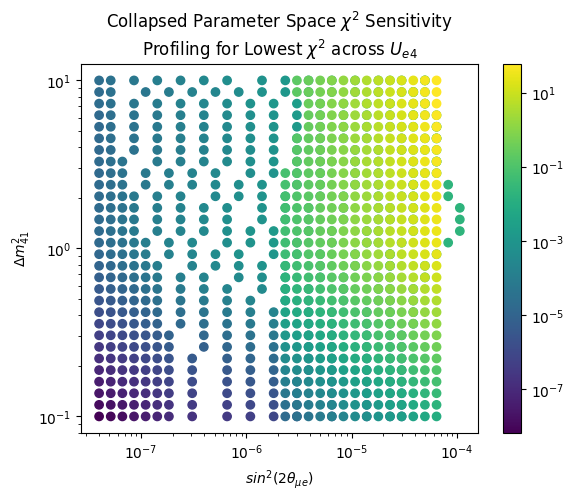

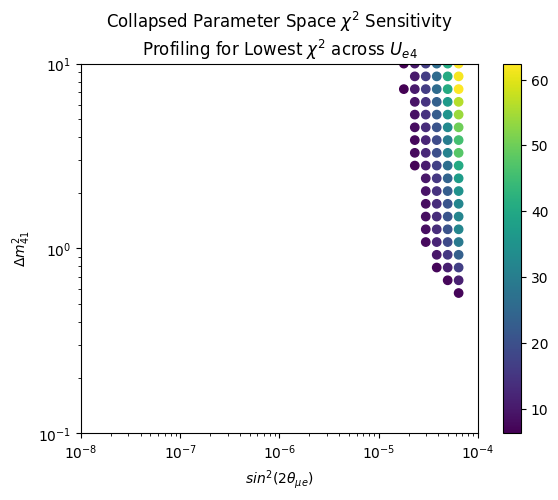

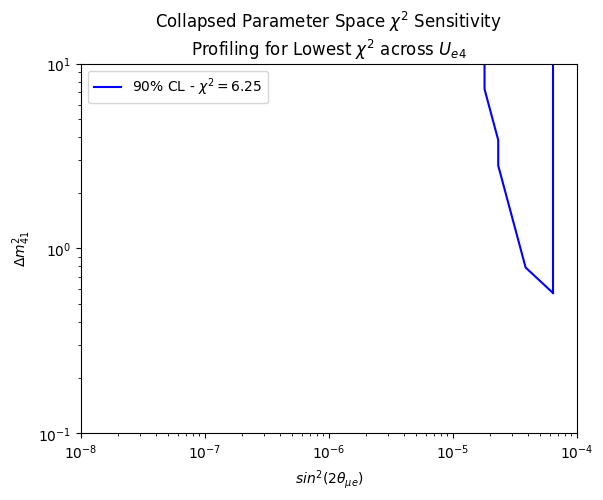

In [252]:
plt.scatter(sinss, mss, c=chi2ss, norm="log")
plt.yscale("log")
plt.xscale("log")
plt.colorbar()
plt.xlabel("$sin^2(2\\theta_{\mu e})$")
plt.ylabel("$\\Delta{m^2_{41}}$")
plt.title("Collapsed Parameter Space $\chi^2$ Sensitivity \nProfiling for Lowest $\chi^2$ across $U_{e4}$")
plt.show()

plt.scatter(sinss[chi2ss > 6.25], mss[chi2ss>6.25], c = chi2ss[chi2ss>6.25])
plt.yscale("log")
plt.xscale("log")
plt.xlim(1e-8, 1e-4)
plt.ylim(0.1,10)
plt.colorbar()
plt.xlabel("$sin^2(2\\theta_{\mu e})$")
plt.ylabel("$\\Delta{m^2_{41}}$")
plt.title("Collapsed Parameter Space $\chi^2$ Sensitivity \nProfiling for Lowest $\chi^2$ across $U_{e4}$")
plt.show()

cr_sins = []
cr_ms = []
for i in range(sinss.shape[0]):
    if ((chi2ss[i] > 6.21) & (chi2ss[i]<7.5)):
        cr_sins.append(sinss[i])
        cr_ms.append(mss[i])
            
index = np.argsort(np.array(cr_ms))
cr_sins_sort = []
cr_ms_sort = []
for i in index:
    cr_sins_sort.append(cr_sins[i])
    cr_ms_sort.append(cr_ms[i])


plt.plot(cr_sins_sort, cr_ms_sort,color="blue", label="90% CL - $\chi^2=6.25$")
plt.plot([cr_sins_sort[0], cr_sins_sort[0]], [cr_ms_sort[-1],cr_ms_sort[0]], color="blue")
plt.yscale("log")
plt.xscale("log")
plt.xlim(1e-8, 1e-4)
plt.ylim(0.1,10)
plt.xlabel("$sin^2(2\\theta_{\mu e})$")
plt.ylabel("$\\Delta{m^2_{41}}$")
plt.title("Collapsed Parameter Space $\chi^2$ Sensitivity \nProfiling for Lowest $\chi^2$ across $U_{e4}$")
plt.legend()
plt.show()
        

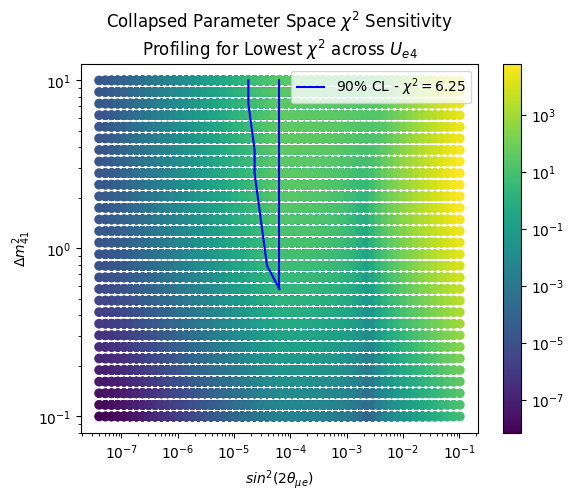

In [253]:
plt.scatter(sin2s_list, deltams_list, c=chi2_list, norm="log")
plt.xscale("log")
plt.yscale("log")
plt.colorbar()

plt.plot(cr_sins_sort, cr_ms_sort,color="blue", label="90% CL - $\chi^2=6.25$")
plt.plot([cr_sins_sort[0], cr_sins_sort[0]], [cr_ms_sort[-1],cr_ms_sort[0]], color="blue")
plt.xlabel("$sin^2(2\\theta_{\mu e})$")
plt.ylabel("$\\Delta{m^2_{41}}$")
plt.title("Collapsed Parameter Space $\chi^2$ Sensitivity \nProfiling for Lowest $\chi^2$ across $U_{e4}$")
plt.legend()
plt.show()

#somehow the profiling is missing ALL of the rightmost points (where I know they are all > 6.25 chi2 from above)

In [242]:
b = new_make_list(np.array(grouplist))

unique vars
[ 0.1         0.11721023  0.13738238  0.1610262   0.18873918  0.22122163
  0.25929438  0.30391954  0.35622479  0.41753189  0.48939009  0.57361525
  0.67233575  0.78804628  0.92367086  1.08263673  1.268961    1.48735211
  1.74332882  2.04335972  2.39502662  2.8072162   3.29034456  3.85662042
  4.52035366  5.29831691  6.21016942  7.27895384  8.53167852 10.        ]
[0.01       0.01135647 0.01289695 0.01464638 0.01663312 0.01888936
 0.02145165 0.02436151 0.02766608 0.0314189  0.03568079 0.04052079
 0.04601733 0.05225945 0.0593483  0.06739873 0.07654118 0.08692378
 0.09871475 0.11210514 0.12731189 0.14458139 0.16419346 0.18646585
 0.21175943 0.24048401 0.273105   0.31015094 0.35222205 0.4       ]
[0.01       0.01135647 0.01289695 0.01464638 0.01663312 0.01888936
 0.02145165 0.02436151 0.02766608 0.0314189  0.03568079 0.04052079
 0.04601733 0.05225945 0.0593483  0.06739873 0.07654118 0.08692378
 0.09871475 0.11210514 0.12731189 0.14458139 0.16419346 0.18646585
 0.21175943 0.2404

In [255]:
mss_b = b[:,0]
ue4ss_b = b[:,1]
um4ss_b = b[:,2]
chi2ss_b = b[:,3]
sinss_b = 4*(ue4ss_b**2)*(um4ss_b**2)

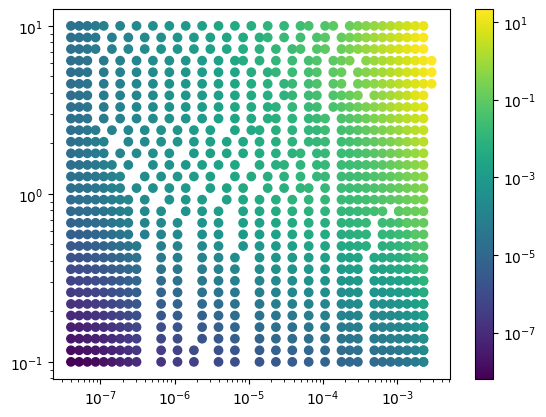

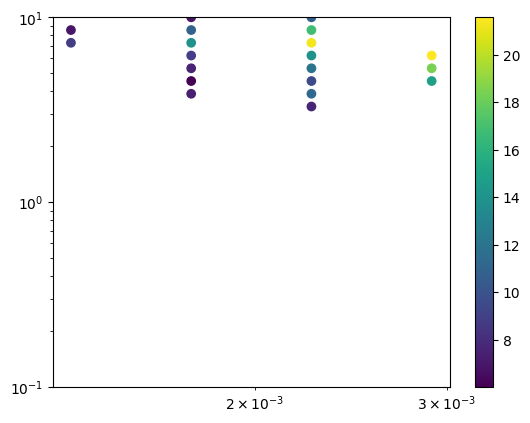

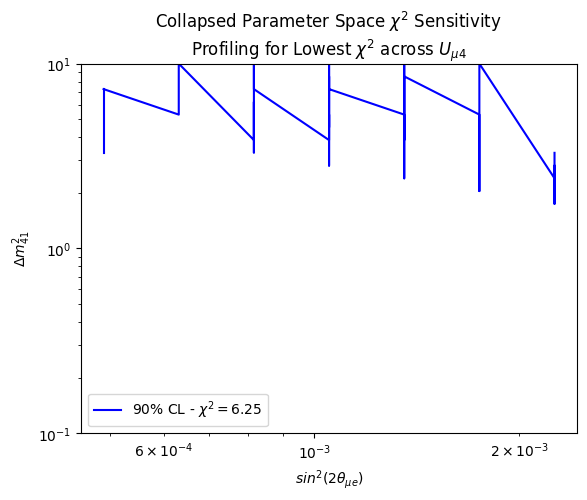

In [269]:
plt.scatter(sinss_b, mss_b, c=chi2ss_b, norm="log")
plt.yscale("log")
plt.xscale("log")
plt.colorbar()
plt.show()

plt.scatter(sinss_b[chi2ss_b > 6], mss_b[chi2ss_b>6], c = chi2ss_b[chi2ss_b>6])
plt.yscale("log")
plt.xscale("log")
# plt.xlim(1e-8, 1e-4)
plt.ylim(0.1,10)
plt.colorbar()
plt.show()

cr_sinsb = []
cr_msb = []
for i in range(sinss_b.shape[0]):
    if ((chi2ss_b[i] > 1) & (chi2ss_b[i]<8)):
        cr_sinsb.append(sinss_b[i])
        cr_msb.append(mss_b[i])
            
indexb = np.argsort(np.array(cr_sinsb))
cr_sins_sortb = []
cr_ms_sortb = []
for i in indexb:
    cr_sins_sortb.append(cr_sinsb[i])
    cr_ms_sortb.append(cr_msb[i])


plt.plot(cr_sins_sortb, cr_ms_sortb,color="blue", label="90% CL - $\chi^2=6.25$")
plt.plot([cr_sins_sortb[0], cr_sins_sortb[0]], [cr_ms_sortb[-1],cr_ms_sortb[0]], color="blue")
plt.yscale("log")
plt.xscale("log")
# plt.xlim(1e-8, 1e-4)
plt.ylim(0.1,10)
plt.xlabel("$sin^2(2\\theta_{\mu e})$")
plt.ylabel("$\\Delta{m^2_{41}}$")
plt.title("Collapsed Parameter Space $\chi^2$ Sensitivity \nProfiling for Lowest $\chi^2$ across $U_{\mu 4}$")
plt.legend()
plt.show()

In [302]:
sin2s_list = np.load("sin2s_list.npy")
deltams_list = np.load("deltams_list.npy")
chi2_list

sins_ms_min_list = []

for i in range(sin2s_list.shape[0]):
    sins_ms_min_list.append([deltams_list[i], sin2s_list[i], chi2_list[i]])
    
sins_ms_min_list = np.array(sins_ms_min_list)

In [305]:
d = make_new_new_list(sins_ms_min_list)

unique vars
[ 0.1         0.11721023  0.13738238  0.1610262   0.18873918  0.22122163
  0.25929438  0.30391954  0.35622479  0.41753189  0.48939009  0.57361525
  0.67233575  0.78804628  0.92367086  1.08263673  1.268961    1.48735211
  1.74332882  2.04335972  2.39502662  2.8072162   3.29034456  3.85662042
  4.52035366  5.29831691  6.21016942  7.27895384  8.53167852 10.        ]
[4.00000000e-08 5.15877857e-08 6.65324909e-08 6.65324909e-08
 8.58065971e-08 1.10664309e-07 1.10664309e-07 1.10664309e-07
 1.42723166e-07 1.42723166e-07 1.84069303e-07 1.84069303e-07
 1.84069303e-07 1.84069303e-07 2.37393194e-07 2.37393194e-07
 2.37393194e-07 3.06164730e-07 3.06164730e-07 3.06164730e-07
 3.06164730e-07 3.94859012e-07 3.94859012e-07 3.94859012e-07
 3.94859012e-07 5.09247553e-07 5.09247553e-07 5.09247553e-07
 5.09247553e-07 5.09247553e-07 6.56773841e-07 6.56773841e-07
 6.56773841e-07 8.47037705e-07 8.47037705e-07 8.47037705e-07
 8.47037705e-07 1.09241999e-06 1.09241999e-06 1.09241999e-06
 1.40888821e

In [306]:
mss_d = d[:,0]
sinss_d = d[:,1]
chi2ss_d = d[:,2]


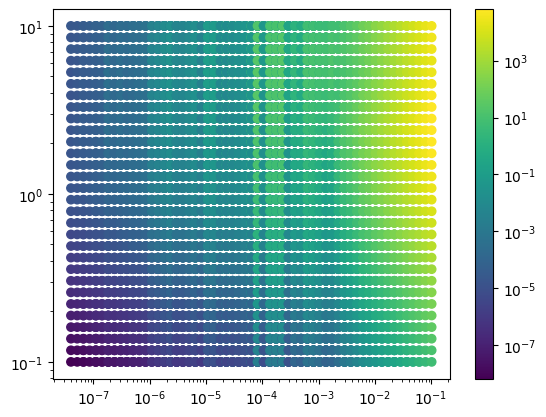

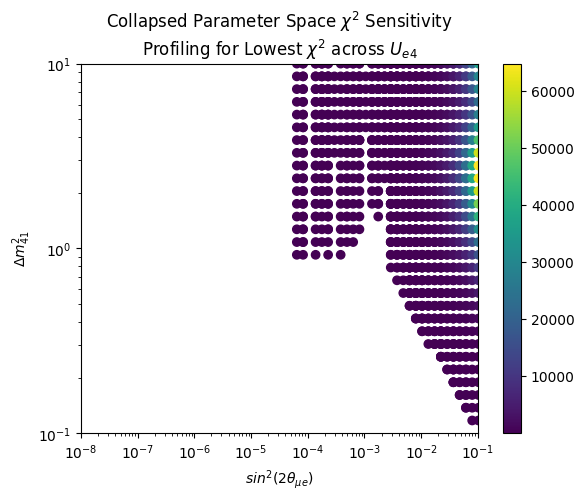

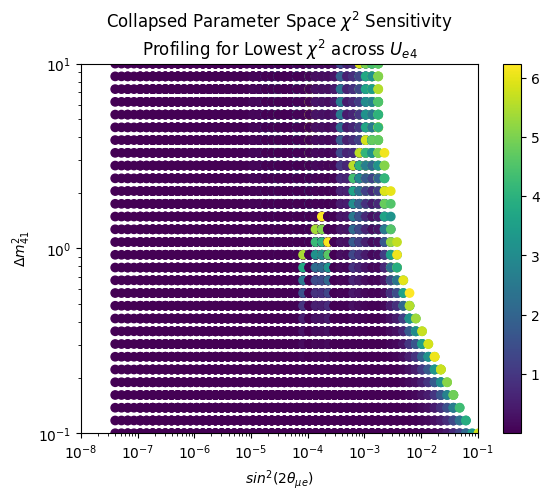

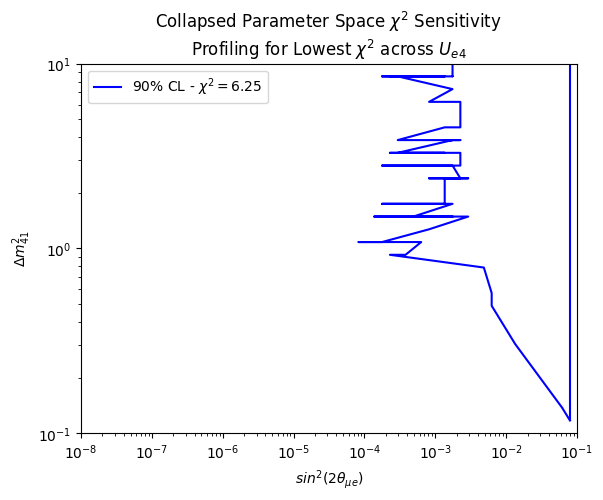

In [318]:
plt.scatter(sinss_d, mss_d, c=chi2ss_d, norm="log")
plt.xscale("log")
plt.yscale("log")
plt.colorbar()
plt.show()

plt.scatter(sinss_d[chi2ss_d > 6.25], mss_d[chi2ss_d>6.25], c = chi2ss_d[chi2ss_d>6.25])
plt.yscale("log")
plt.xscale("log")
plt.xlim(1e-8, 1e-1)
plt.ylim(0.1,10)
plt.colorbar()
plt.xlabel("$sin^2(2\\theta_{\mu e})$")
plt.ylabel("$\\Delta{m^2_{41}}$")
plt.title("Collapsed Parameter Space $\chi^2$ Sensitivity \nProfiling for Lowest $\chi^2$ across $U_{e4}$")
plt.show()

plt.scatter(sinss_d[chi2ss_d < 6.25], mss_d[chi2ss_d<6.25], c = chi2ss_d[chi2ss_d<6.25])
plt.yscale("log")
plt.xscale("log")
plt.xlim(1e-8, 1e-1)
plt.ylim(0.1,10)
plt.colorbar()
plt.xlabel("$sin^2(2\\theta_{\mu e})$")
plt.ylabel("$\\Delta{m^2_{41}}$")
plt.title("Collapsed Parameter Space $\chi^2$ Sensitivity \nProfiling for Lowest $\chi^2$ across $U_{e4}$")
plt.show()

cr_sinsd = []
cr_msd = []
for i in range(sinss_d.shape[0]):
    if ((chi2ss_d[i] > 6.21) & (chi2ss_d[i]<7.5)):
        cr_sinsd.append(sinss_d[i])
        cr_msd.append(mss_d[i])
            
indexd = np.argsort(np.array(cr_msd))
cr_sins_sortd = []
cr_ms_sortd = []
for i in indexd:
    cr_sins_sortd.append(cr_sinsd[i])
    cr_ms_sortd.append(cr_msd[i])


plt.plot(cr_sins_sortd, cr_ms_sortd,color="blue", label="90% CL - $\chi^2=6.25$")
plt.plot([cr_sins_sortd[0], cr_sins_sortd[0]], [cr_ms_sortd[-1],cr_ms_sortd[0]], color="blue")
plt.yscale("log")
plt.xscale("log")
plt.xlim(1e-8, 1e-1)
plt.ylim(0.1,10)
plt.xlabel("$sin^2(2\\theta_{\mu e})$")
plt.ylabel("$\\Delta{m^2_{41}}$")
plt.title("Collapsed Parameter Space $\chi^2$ Sensitivity \nProfiling for Lowest $\chi^2$ across $U_{e4}$")
plt.legend()
plt.show()